<a href="https://colab.research.google.com/github/KhoiDOO/Practice/blob/main/Generative%20Deep%20Learning/Pytorch/4%20Conditional_GAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Build a Conditional GAN

#### Packages and Visualization

In [ ]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [ ]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [ ]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels in the images, fitted for the dataset used, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.


In [ ]:
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    return F.one_hot(labels,n_classes)

In [ ]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
# Check that the device of get_one_hot_labels matches the input device
if torch.cuda.is_available():
    assert str(get_one_hot_labels(torch.Tensor([[0]]).long().cuda(), 1).device).startswith("cuda")
    
print("Success!")

Success!


In [ ]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    combined = torch.cat((x.float(),y.float()), 1)
    #### END CODE HERE ####
    return combined

In [ ]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]))
if torch.cuda.is_available():
    # Check that it doesn't break with cuda
    cuda_check = combine_vectors(torch.tensor([[1, 2], [3, 4]]).cuda(), torch.tensor([[5, 6], [7, 8]]).cuda())
    assert str(cuda_check.device).startswith("cuda")
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
# Check that the float transformation doesn't happen after the inputs are concatenated
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12)).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [ ]:
mnist_shape = (1, 28, 28)
n_classes = 10

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [ ]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

In [ ]:
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    return generator_input_dim, discriminator_im_chan

In [ ]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [ ]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Epoch 1, step 500: Generator loss: 2.105744392871857, discriminator loss: 0.2659258508980274


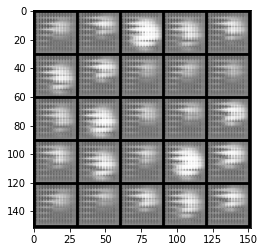

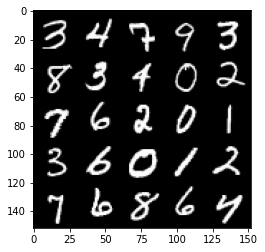

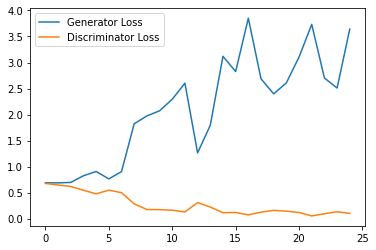

Epoch 2, step 1000: Generator loss: 4.346643468618393, discriminator loss: 0.061783104613423345


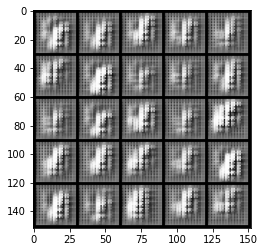

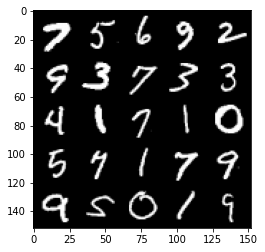

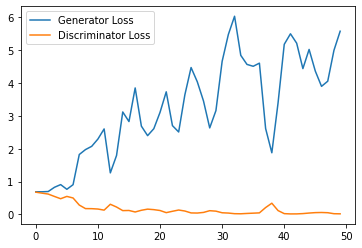

Epoch 3, step 1500: Generator loss: 4.325257460594178, discriminator loss: 0.05487396846152842


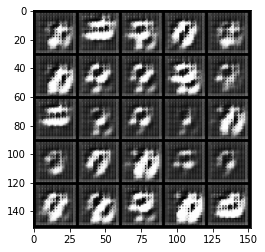

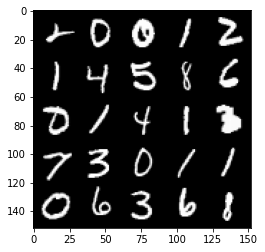

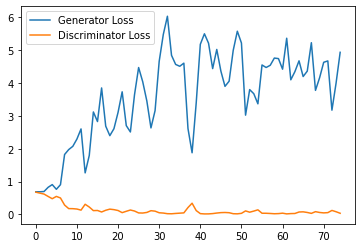

Epoch 4, step 2000: Generator loss: 4.19560376739502, discriminator loss: 0.06154721598699689


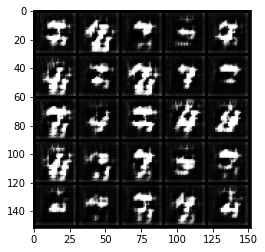

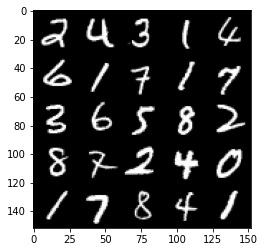

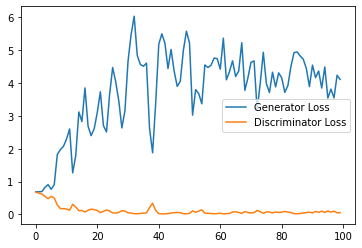

Epoch 5, step 2500: Generator loss: 3.2564828002452852, discriminator loss: 0.16623649299144744


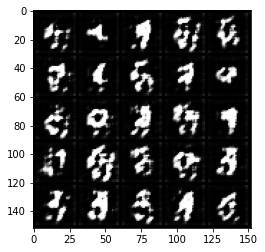

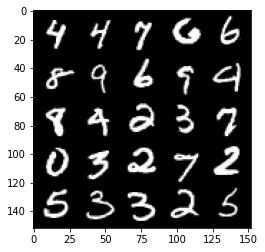

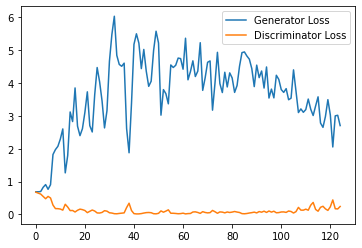

Epoch 6, step 3000: Generator loss: 2.861775984287262, discriminator loss: 0.2158397037833929


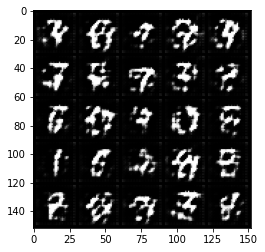

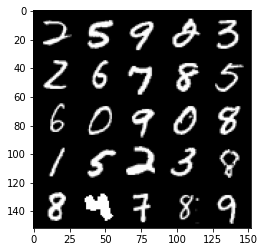

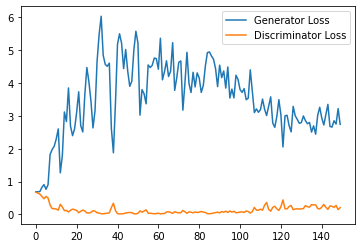

Epoch 7, step 3500: Generator loss: 2.6097826406955718, discriminator loss: 0.27273832346498966


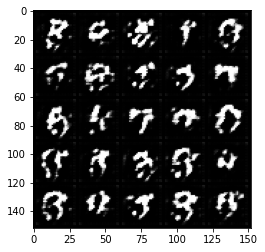

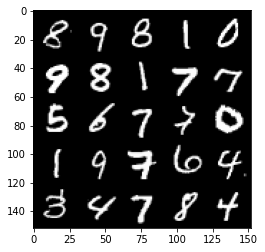

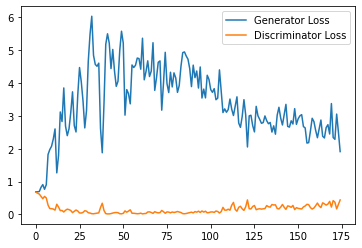

Epoch 8, step 4000: Generator loss: 2.3024410655498504, discriminator loss: 0.2969106656908989


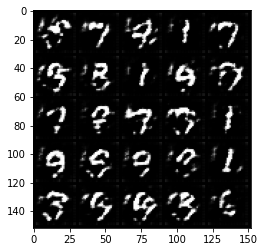

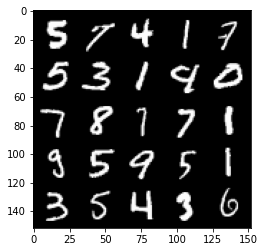

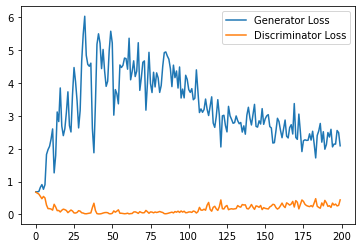

Epoch 9, step 4500: Generator loss: 2.1804179433584214, discriminator loss: 0.34007943420112136


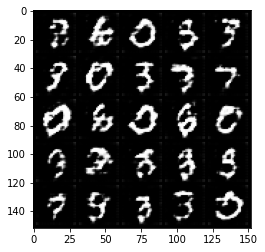

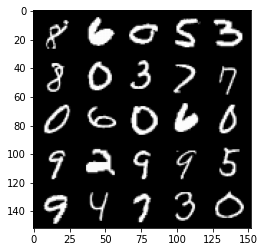

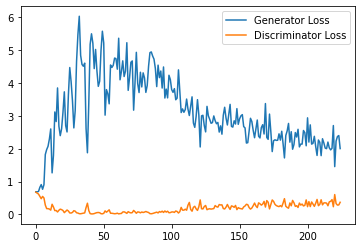

Epoch 10, step 5000: Generator loss: 1.8516554155349731, discriminator loss: 0.36733349567651746


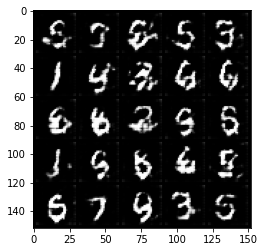

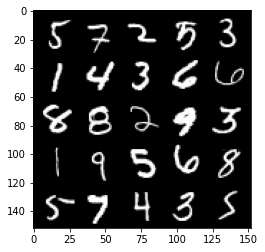

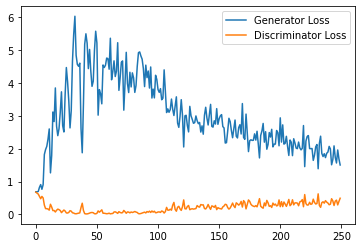

Epoch 11, step 5500: Generator loss: 1.8083885114192964, discriminator loss: 0.37940846344828605


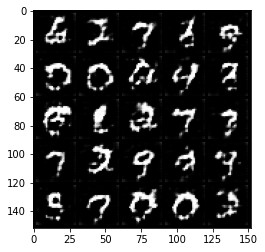

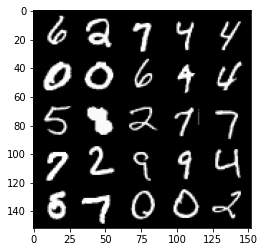

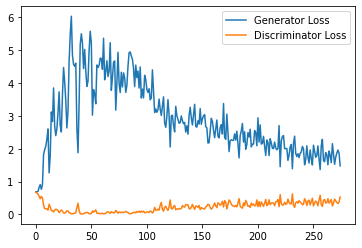

Epoch 12, step 6000: Generator loss: 1.8564278740882874, discriminator loss: 0.3974611144065857


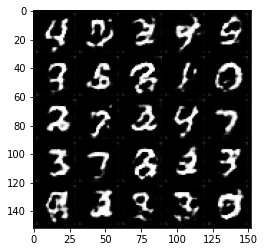

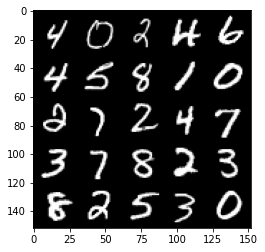

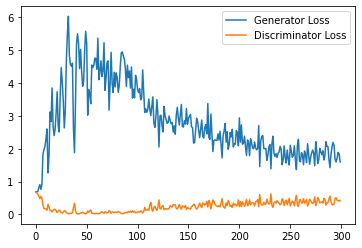

Epoch 13, step 6500: Generator loss: 1.6609581040143966, discriminator loss: 0.42435269835591316


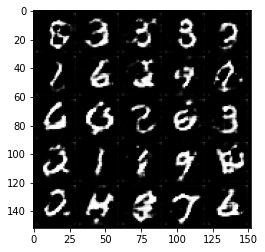

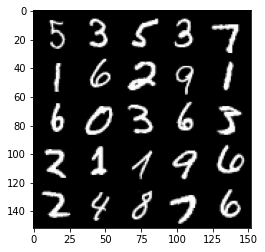

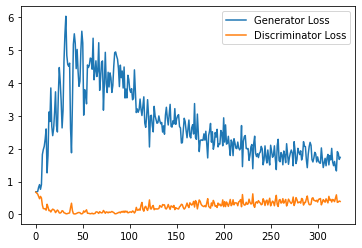

Epoch 14, step 7000: Generator loss: 1.525275194644928, discriminator loss: 0.4441448047757149


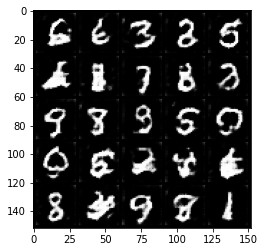

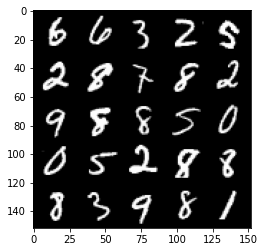

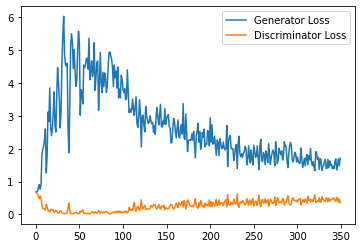

Epoch 15, step 7500: Generator loss: 1.5471420555114745, discriminator loss: 0.46494634985923766


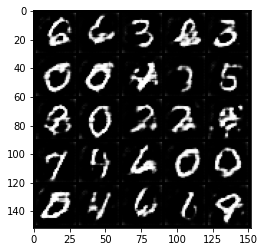

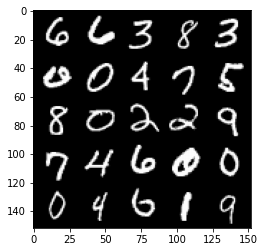

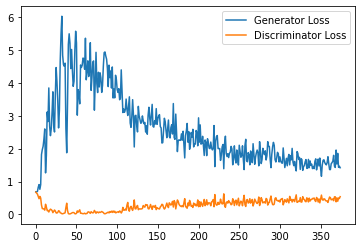

Epoch 17, step 8000: Generator loss: 1.4141540017127991, discriminator loss: 0.48040563929080965


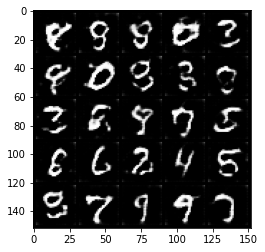

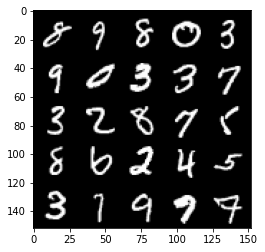

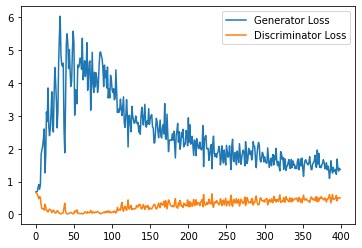

Epoch 18, step 8500: Generator loss: 1.3656918073892594, discriminator loss: 0.4911153728365898


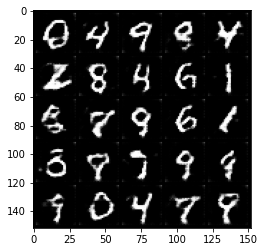

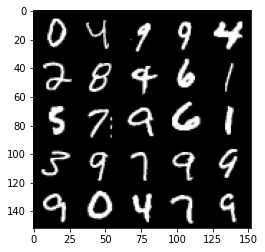

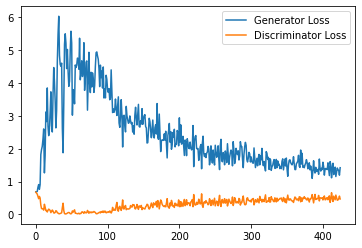

Epoch 19, step 9000: Generator loss: 1.3679803754091262, discriminator loss: 0.4856884633302689


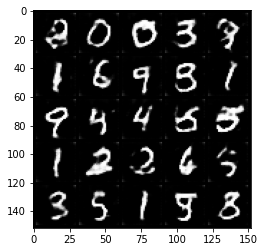

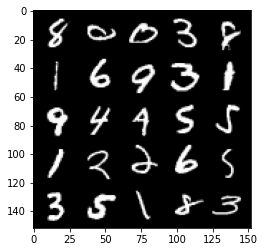

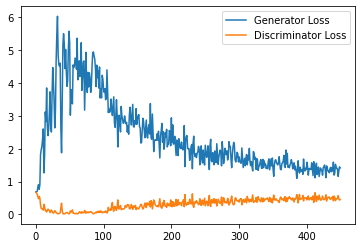

Epoch 20, step 9500: Generator loss: 1.3512352228164672, discriminator loss: 0.5218258334994316


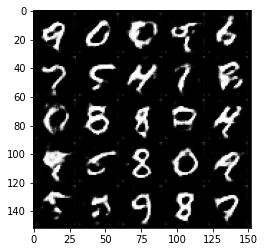

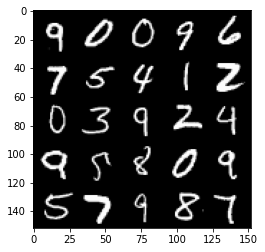

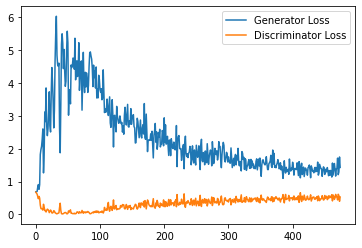

Epoch 21, step 10000: Generator loss: 1.3494593603610991, discriminator loss: 0.5239474303126335


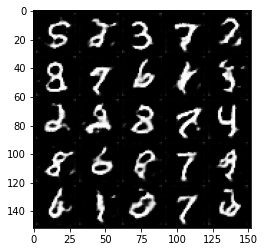

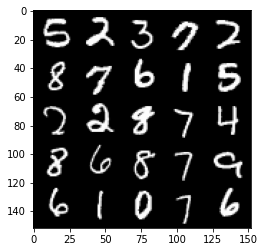

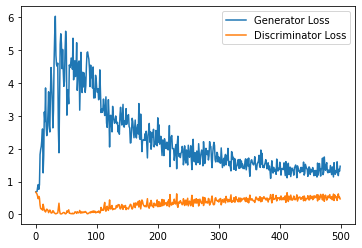

Epoch 22, step 10500: Generator loss: 1.272020901322365, discriminator loss: 0.5347931733131409


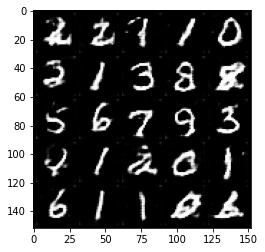

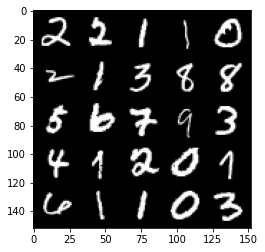

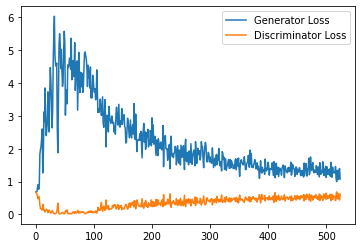

Epoch 23, step 11000: Generator loss: 1.200065038204193, discriminator loss: 0.5403805757164956


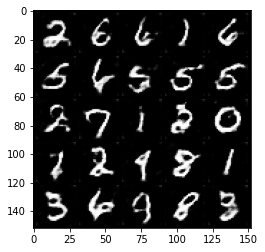

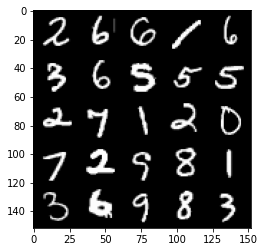

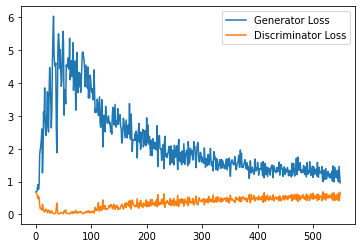

Epoch 24, step 11500: Generator loss: 1.1458433970212936, discriminator loss: 0.5511269724965095


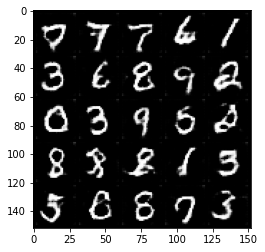

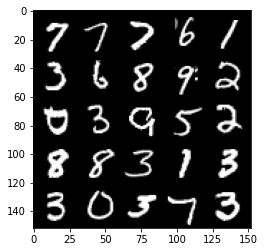

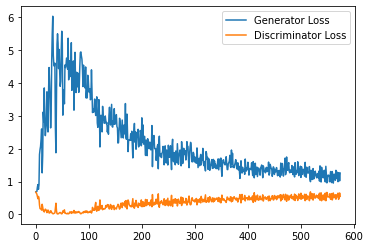

Epoch 25, step 12000: Generator loss: 1.2158493427038193, discriminator loss: 0.5590262133479118


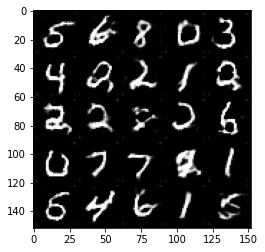

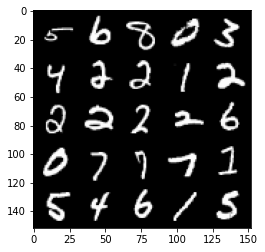

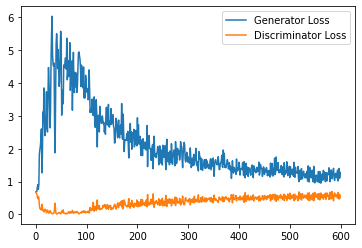

Epoch 26, step 12500: Generator loss: 1.1412701148986817, discriminator loss: 0.5617332704663277


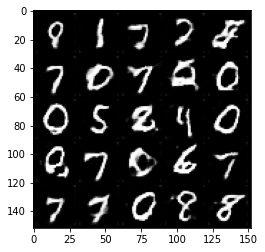

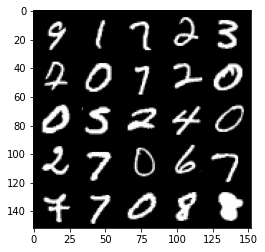

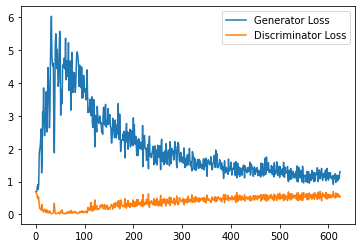

Epoch 27, step 13000: Generator loss: 1.1636654963493347, discriminator loss: 0.5770926033854484


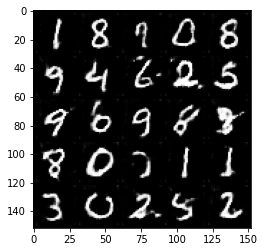

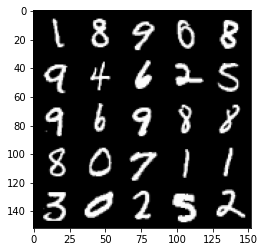

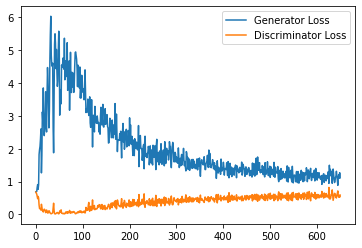

Epoch 28, step 13500: Generator loss: 1.1289305144548416, discriminator loss: 0.5685252640843391


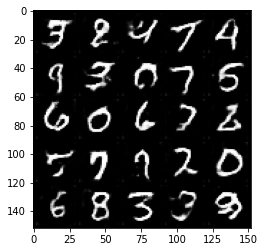

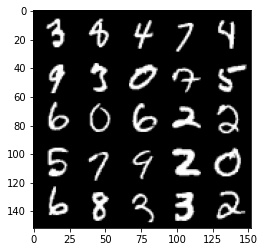

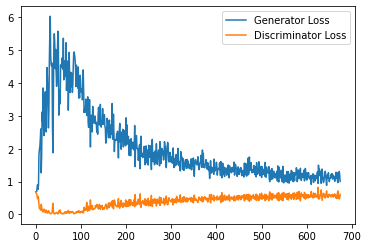

Epoch 29, step 14000: Generator loss: 1.087765502691269, discriminator loss: 0.5765254997611046


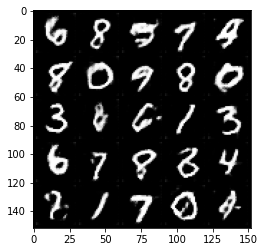

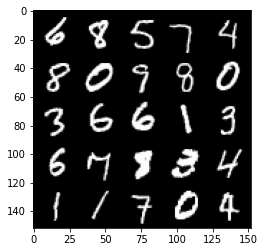

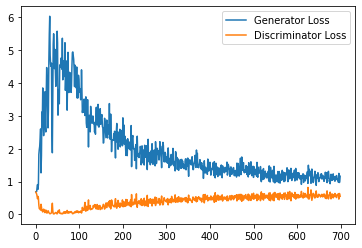

Epoch 30, step 14500: Generator loss: 1.0623524701595306, discriminator loss: 0.5838468636870384


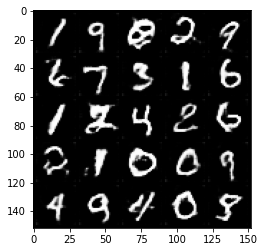

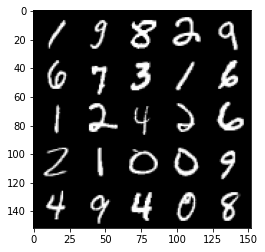

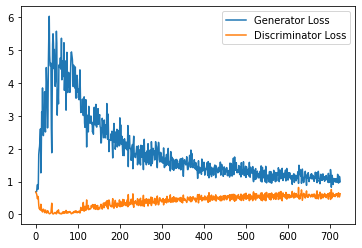

Epoch 31, step 15000: Generator loss: 1.0662575484514236, discriminator loss: 0.5929276562929153


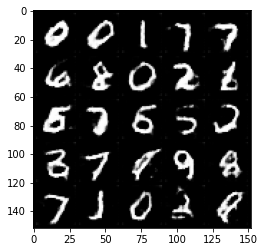

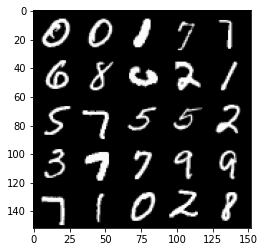

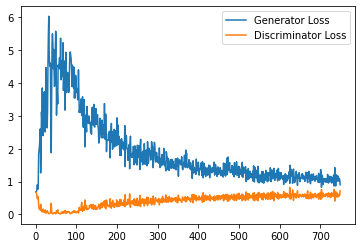

Epoch 33, step 15500: Generator loss: 1.1058521090745925, discriminator loss: 0.5872031992077827


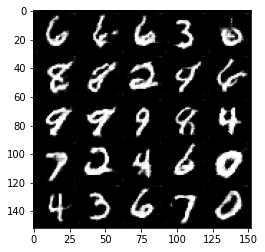

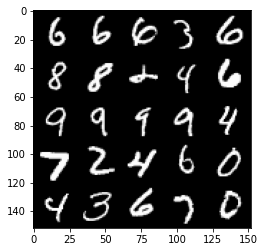

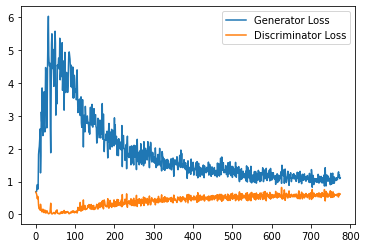

Epoch 34, step 16000: Generator loss: 1.1343740929365158, discriminator loss: 0.5740186772346496


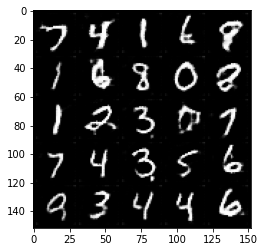

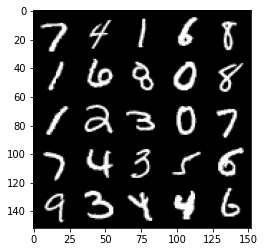

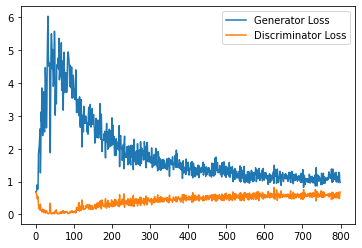

Epoch 35, step 16500: Generator loss: 1.0318202955722808, discriminator loss: 0.5981028532385826


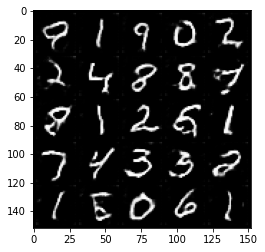

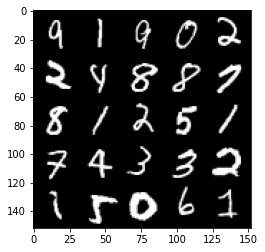

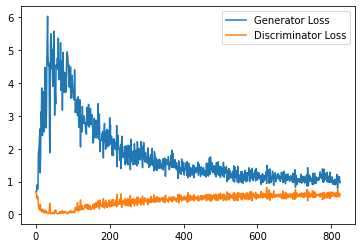

Epoch 36, step 17000: Generator loss: 1.0483379147052765, discriminator loss: 0.5898180636167526


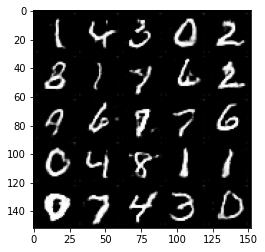

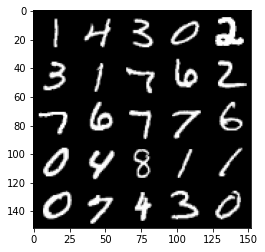

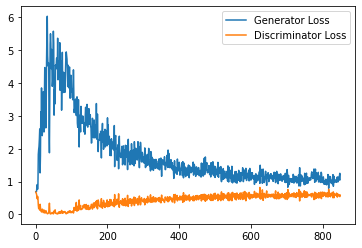

Epoch 37, step 17500: Generator loss: 1.0950197167396545, discriminator loss: 0.5964713057279587


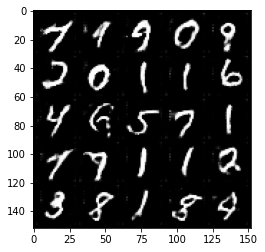

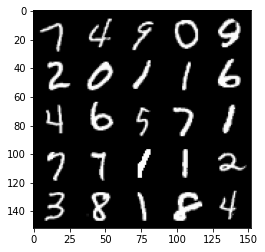

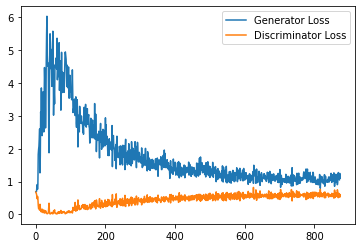

Epoch 38, step 18000: Generator loss: 1.0407891248464585, discriminator loss: 0.5912973347902298


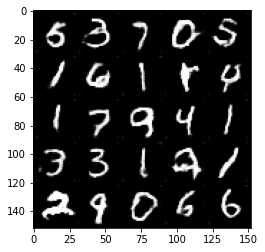

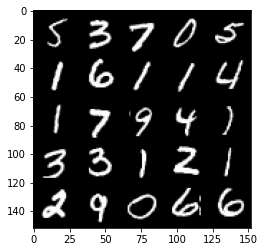

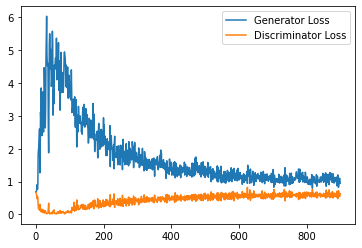

Epoch 39, step 18500: Generator loss: 0.9990477825403213, discriminator loss: 0.6028715780973435


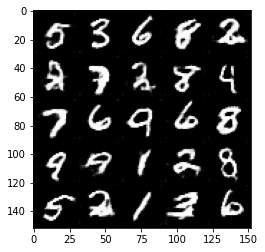

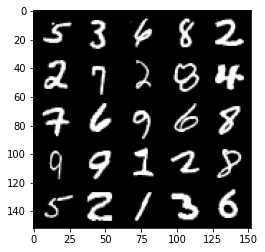

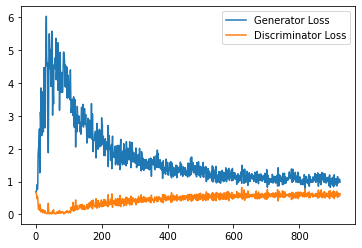

Epoch 40, step 19000: Generator loss: 1.0236733351945877, discriminator loss: 0.6007033879160881


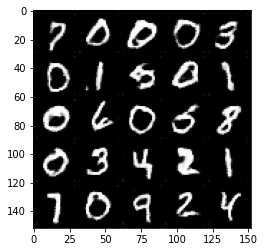

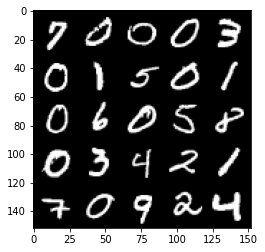

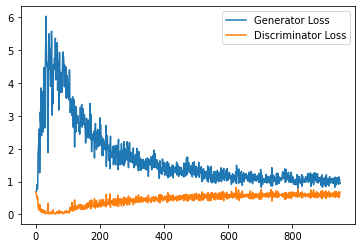

Epoch 41, step 19500: Generator loss: 1.0169294438362122, discriminator loss: 0.5987808749079704


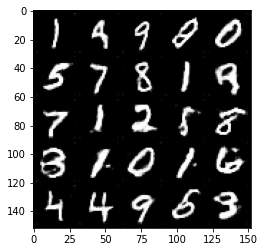

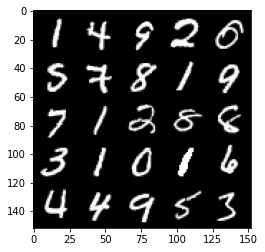

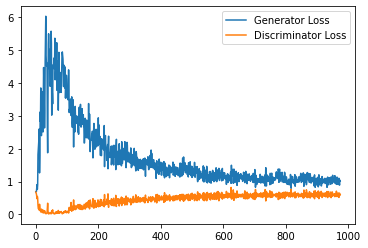

Epoch 42, step 20000: Generator loss: 0.985890398144722, discriminator loss: 0.6032019617557526


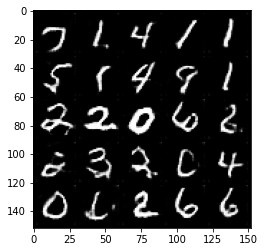

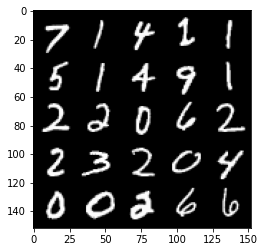

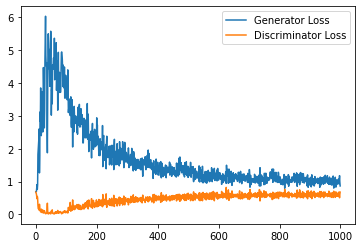

Epoch 43, step 20500: Generator loss: 1.0007707403898238, discriminator loss: 0.6028732722997665


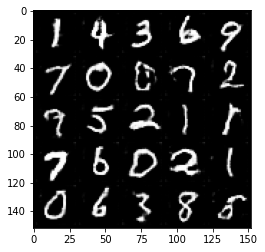

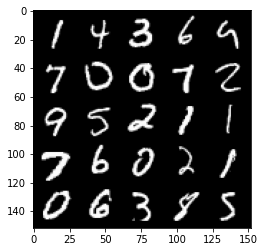

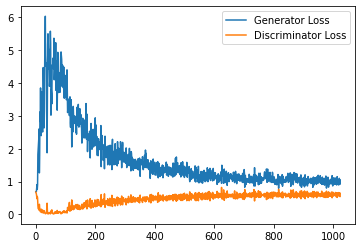

Epoch 44, step 21000: Generator loss: 0.9863899277448654, discriminator loss: 0.607705933868885


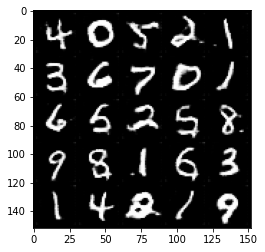

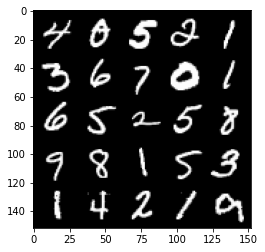

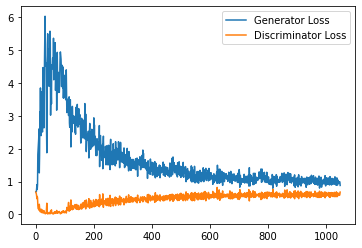

Epoch 45, step 21500: Generator loss: 1.0420483787059784, discriminator loss: 0.6050066494345665


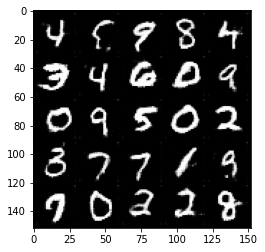

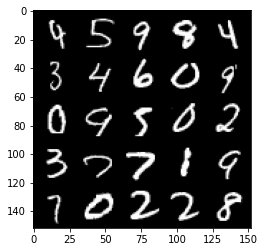

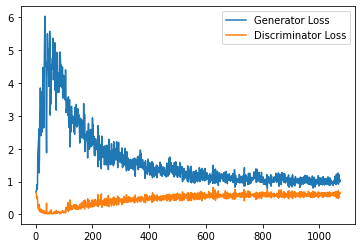

Epoch 46, step 22000: Generator loss: 1.000989359021187, discriminator loss: 0.6113653871417045


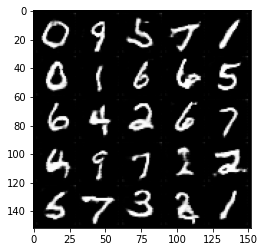

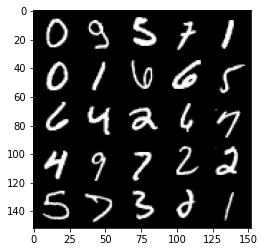

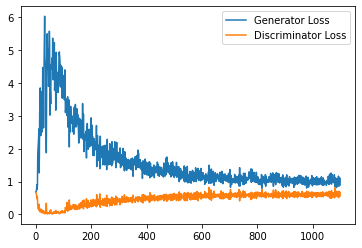

Epoch 47, step 22500: Generator loss: 0.9797966676950455, discriminator loss: 0.601784415602684


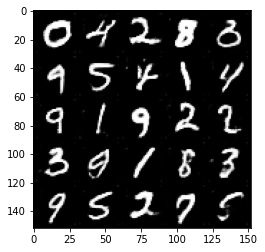

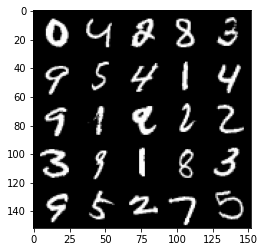

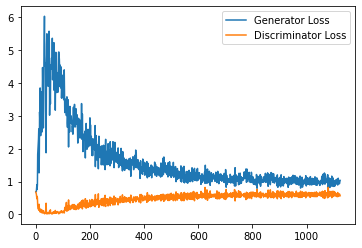

Epoch 49, step 23000: Generator loss: 0.9827783446311951, discriminator loss: 0.6030797100067139


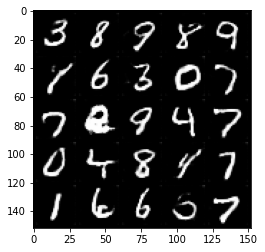

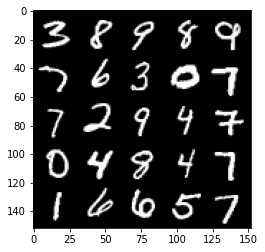

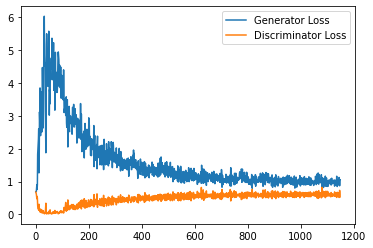

Epoch 50, step 23500: Generator loss: 0.9574431321620941, discriminator loss: 0.6131398859024048


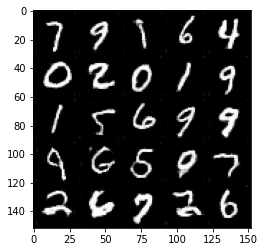

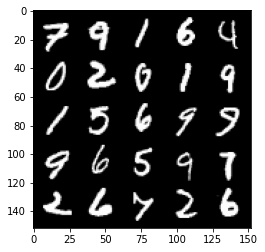

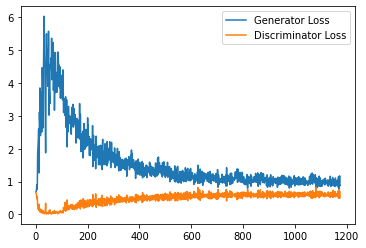

Epoch 51, step 24000: Generator loss: 0.9692932226657868, discriminator loss: 0.6052401153445244


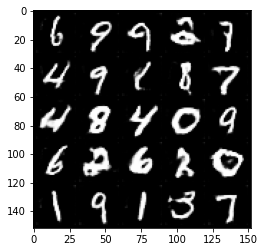

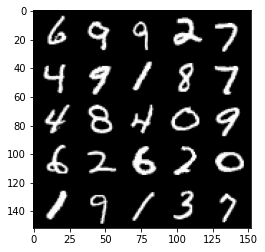

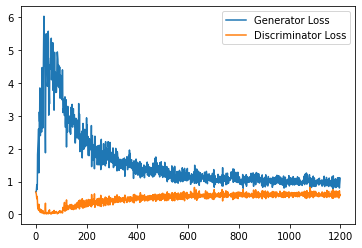

Epoch 52, step 24500: Generator loss: 0.9870793184041977, discriminator loss: 0.6073783577680588


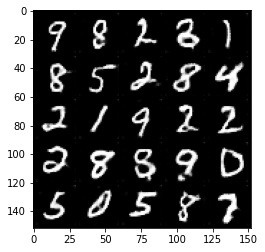

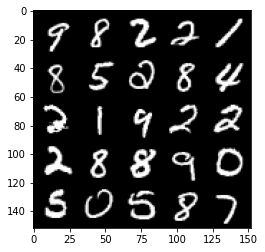

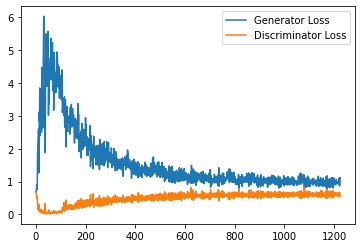

Epoch 53, step 25000: Generator loss: 0.9649397398233414, discriminator loss: 0.6140222271680832


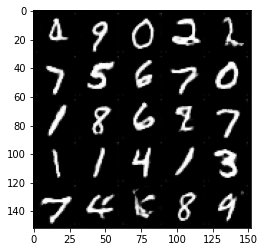

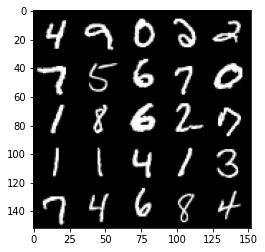

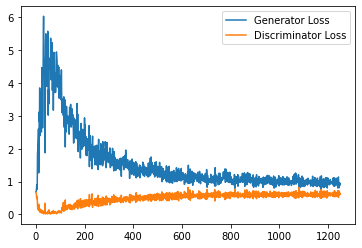

Epoch 54, step 25500: Generator loss: 0.9562650892734528, discriminator loss: 0.6109812795519829


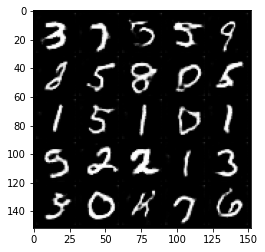

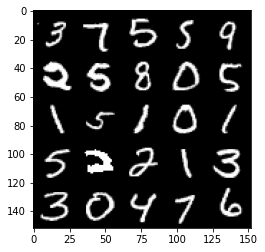

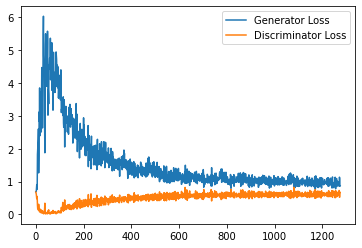

Epoch 55, step 26000: Generator loss: 0.9547613775730133, discriminator loss: 0.6133743499517441


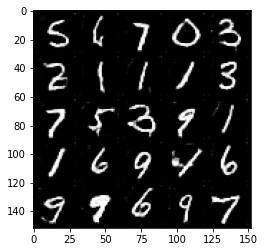

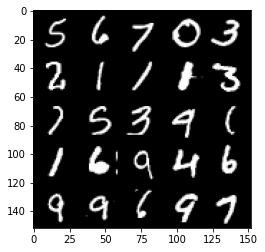

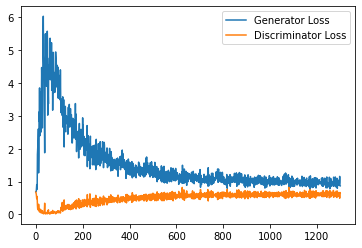

Epoch 56, step 26500: Generator loss: 0.9600718350410461, discriminator loss: 0.6076551927924156


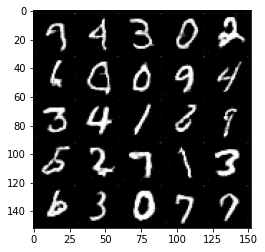

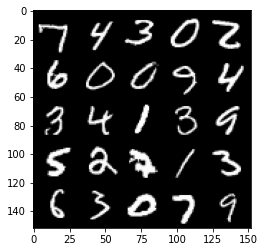

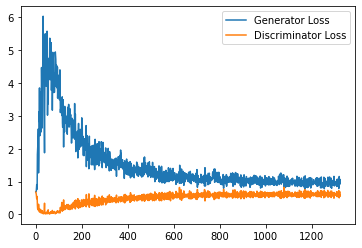

Epoch 57, step 27000: Generator loss: 0.9431385521888733, discriminator loss: 0.6184012992978096


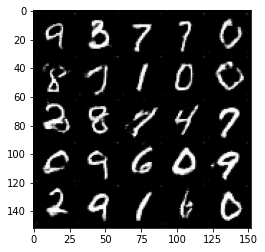

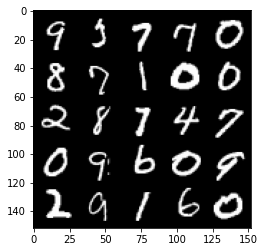

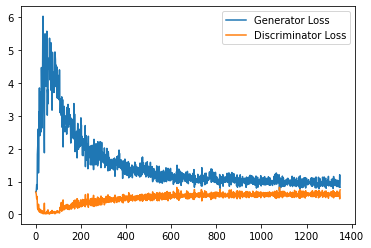

Epoch 58, step 27500: Generator loss: 0.9610080857276917, discriminator loss: 0.6080940769314765


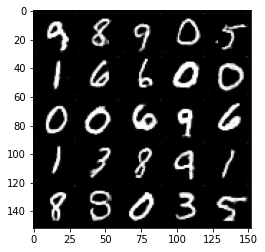

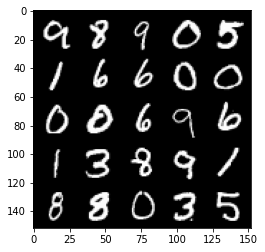

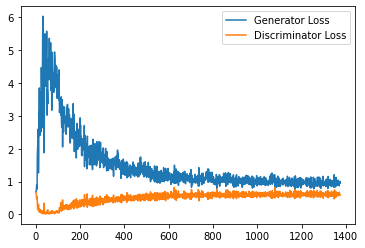

Epoch 59, step 28000: Generator loss: 0.9381682510375977, discriminator loss: 0.6169900361895562


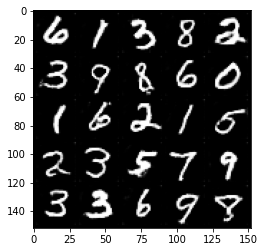

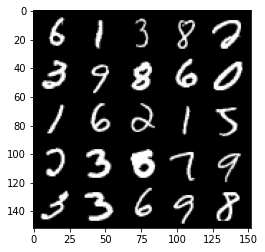

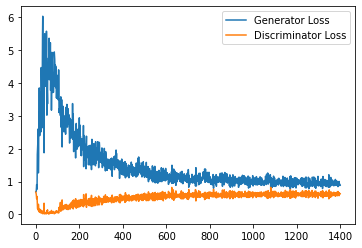

Epoch 60, step 28500: Generator loss: 0.9474744716882706, discriminator loss: 0.6237779285311699


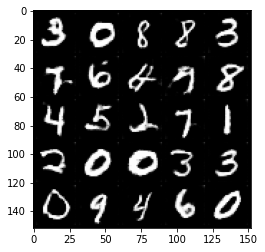

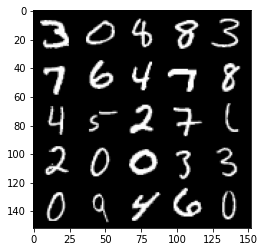

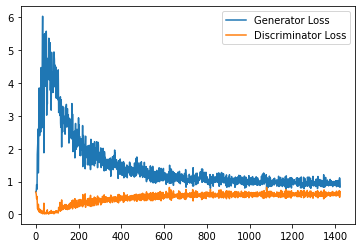

Epoch 61, step 29000: Generator loss: 0.963246354341507, discriminator loss: 0.6192890634536743


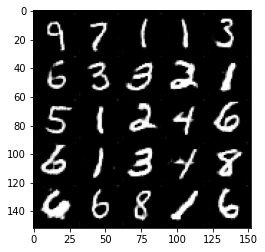

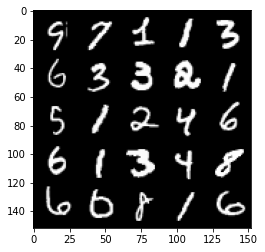

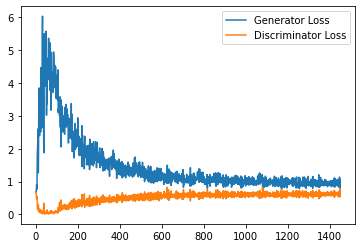

Epoch 62, step 29500: Generator loss: 0.948797526717186, discriminator loss: 0.6177035240530968


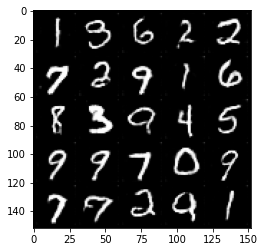

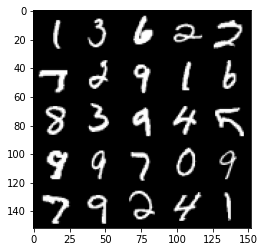

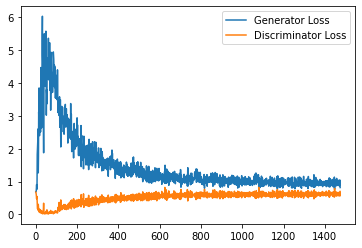

Epoch 63, step 30000: Generator loss: 0.9449081114530563, discriminator loss: 0.6258096659183502


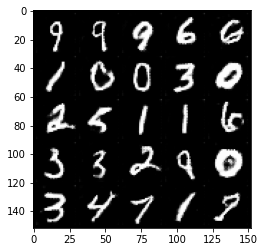

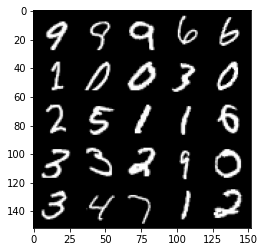

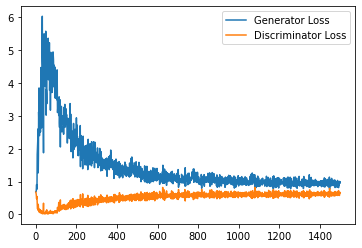

Epoch 65, step 30500: Generator loss: 0.9491596443653106, discriminator loss: 0.6136455146074296


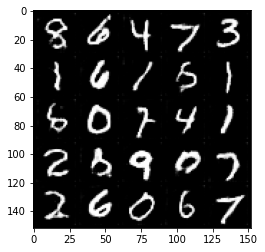

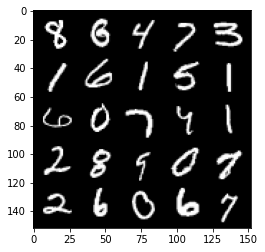

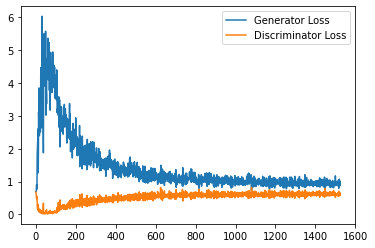

Epoch 66, step 31000: Generator loss: 0.9359605350494384, discriminator loss: 0.6239909691810608


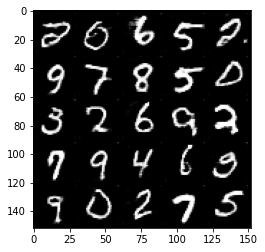

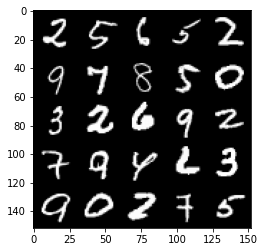

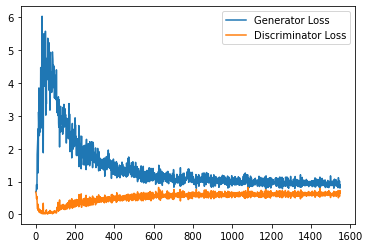

Epoch 67, step 31500: Generator loss: 0.9372634083032608, discriminator loss: 0.6177260855436325


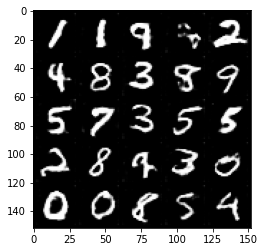

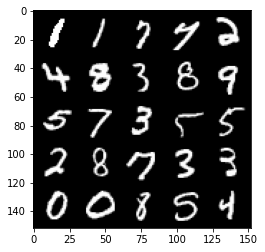

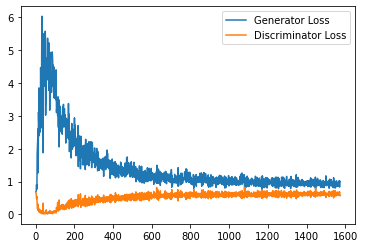

Epoch 68, step 32000: Generator loss: 0.9330268602371216, discriminator loss: 0.6265711066126823


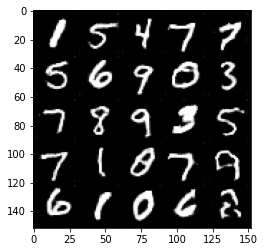

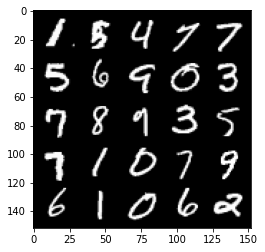

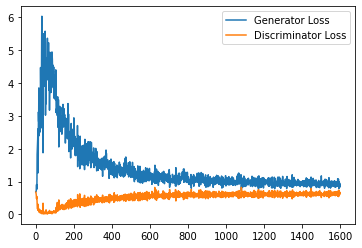

Epoch 69, step 32500: Generator loss: 0.9072127523422241, discriminator loss: 0.6242276411652565


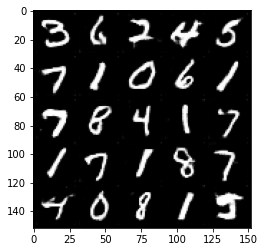

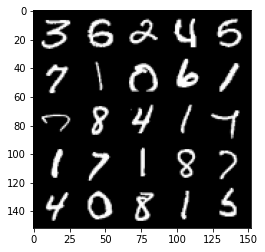

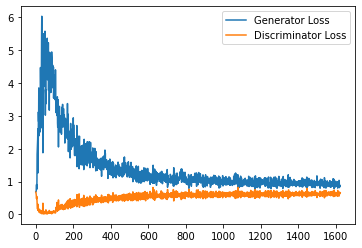

Epoch 70, step 33000: Generator loss: 0.9299146111011505, discriminator loss: 0.6177207673192024


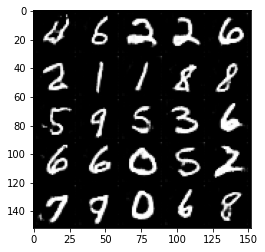

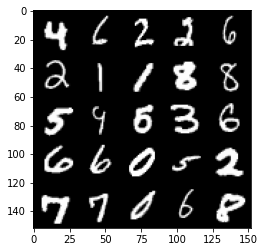

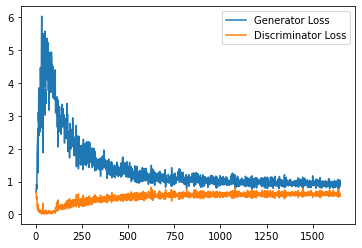

Epoch 71, step 33500: Generator loss: 0.9199717260599136, discriminator loss: 0.6199555784463883


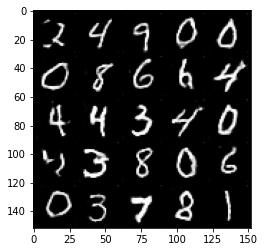

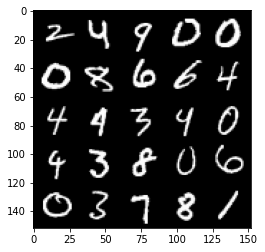

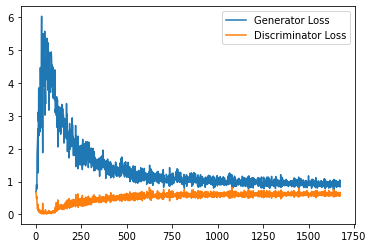

Epoch 72, step 34000: Generator loss: 0.9394511158466339, discriminator loss: 0.6223758796453476


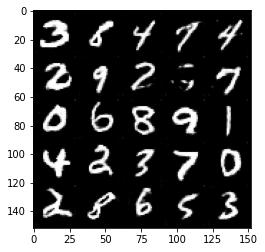

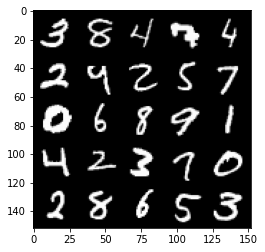

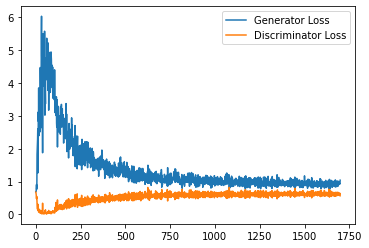

Epoch 73, step 34500: Generator loss: 0.9642099177837372, discriminator loss: 0.6259214880466462


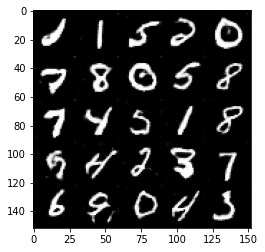

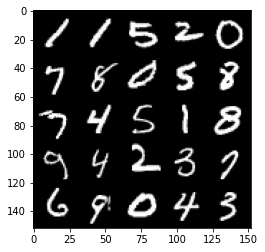

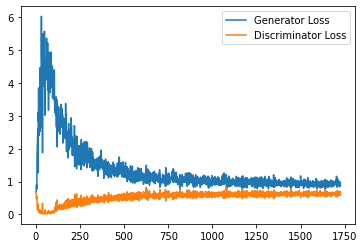

Epoch 74, step 35000: Generator loss: 0.9100067145824432, discriminator loss: 0.6196930047273636


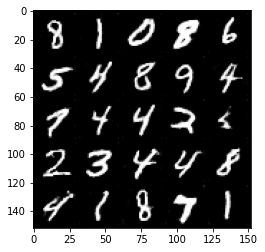

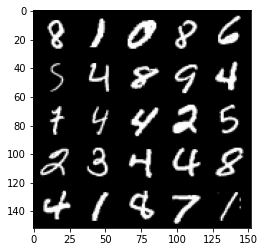

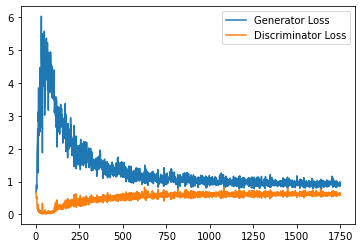

Epoch 75, step 35500: Generator loss: 0.9413214478492736, discriminator loss: 0.6135888736248016


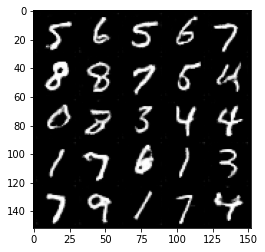

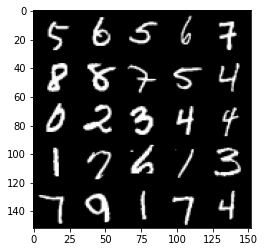

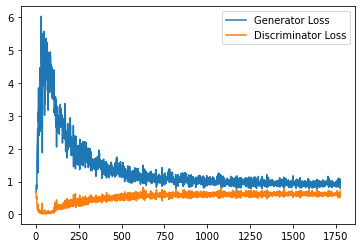

Epoch 76, step 36000: Generator loss: 0.9342762964963913, discriminator loss: 0.6203841150403023


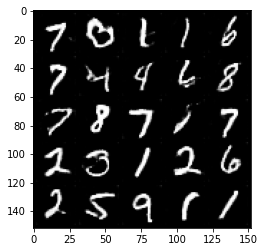

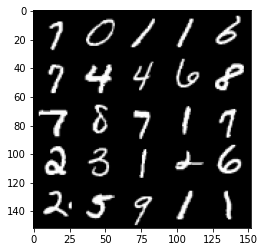

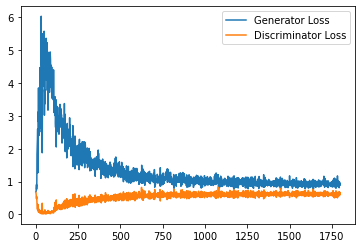

Epoch 77, step 36500: Generator loss: 0.9158364877700805, discriminator loss: 0.6179288663268089


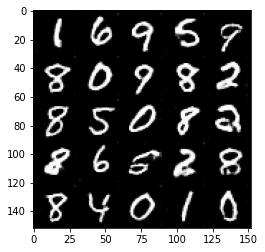

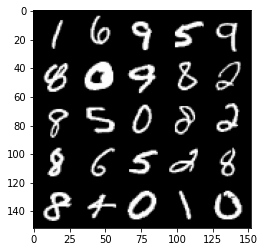

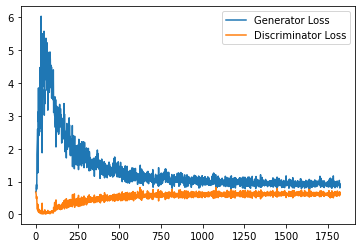

Epoch 78, step 37000: Generator loss: 0.9312090578079224, discriminator loss: 0.6136991099119187


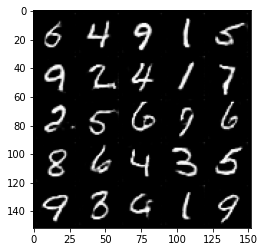

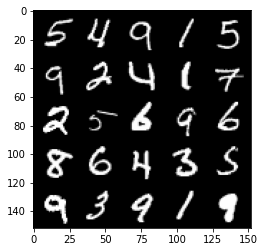

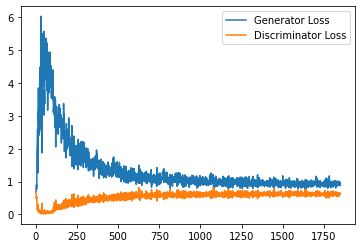

Epoch 79, step 37500: Generator loss: 0.9177509949207306, discriminator loss: 0.6195679941177368


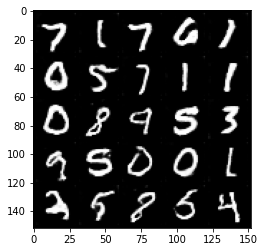

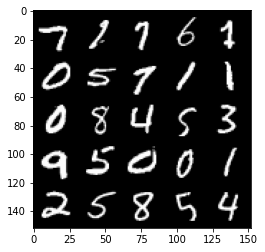

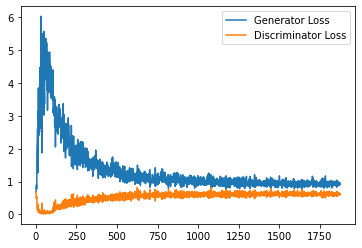

Epoch 81, step 38000: Generator loss: 0.910753327012062, discriminator loss: 0.6216633484363556


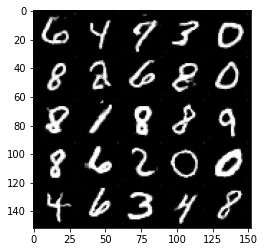

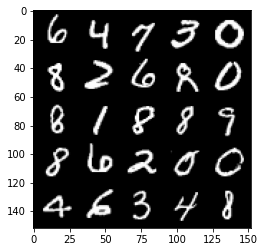

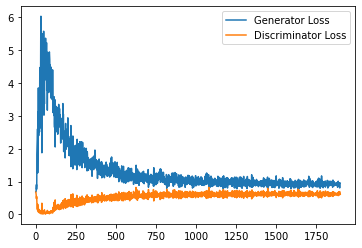

Epoch 82, step 38500: Generator loss: 0.9328544478416443, discriminator loss: 0.614074598133564


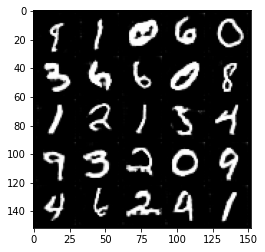

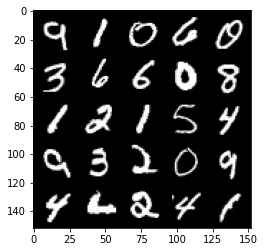

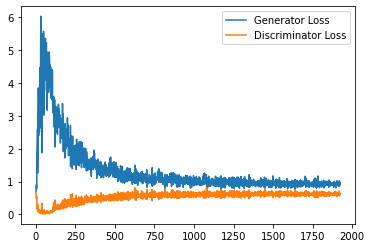

Epoch 83, step 39000: Generator loss: 0.9483578325510025, discriminator loss: 0.6146073359251022


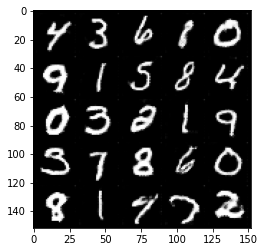

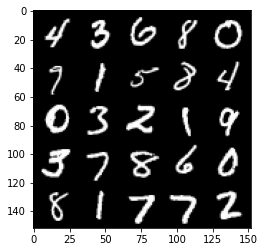

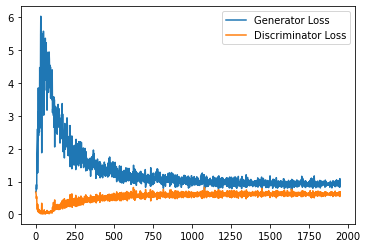

Epoch 84, step 39500: Generator loss: 0.9404771800041198, discriminator loss: 0.6060126422047615


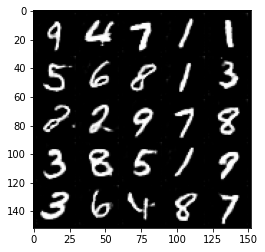

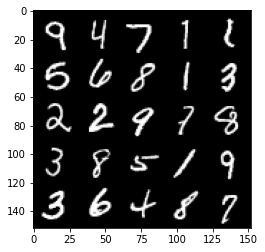

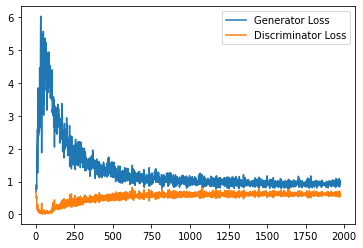

Epoch 85, step 40000: Generator loss: 0.9306073591709138, discriminator loss: 0.6131705482006073


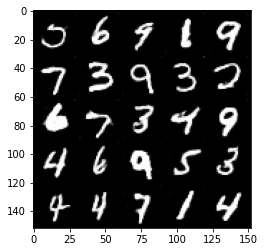

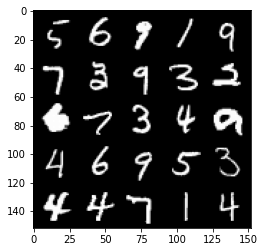

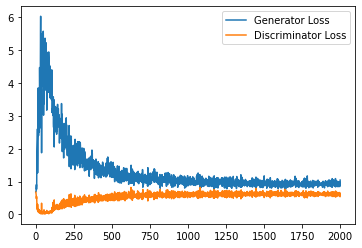

Epoch 86, step 40500: Generator loss: 0.9256143770217895, discriminator loss: 0.6147478796243667


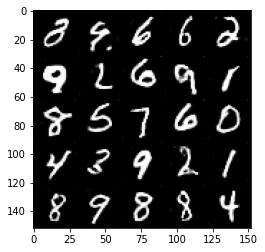

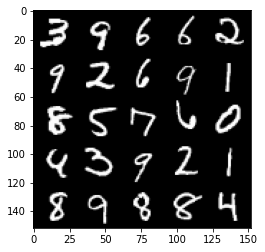

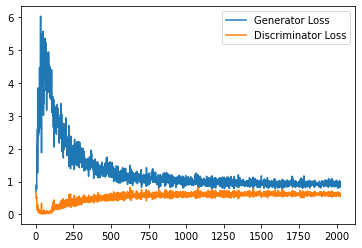

Epoch 87, step 41000: Generator loss: 0.9256743215322495, discriminator loss: 0.6158849114179611


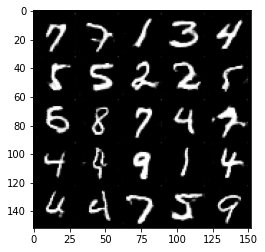

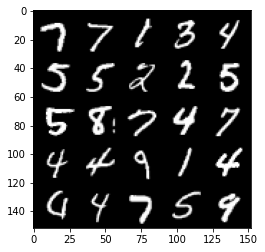

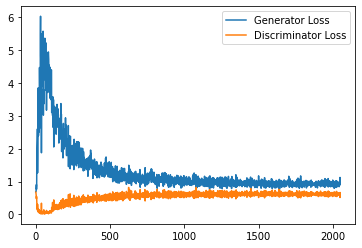

Epoch 88, step 41500: Generator loss: 0.9413402981162071, discriminator loss: 0.6121175409555435


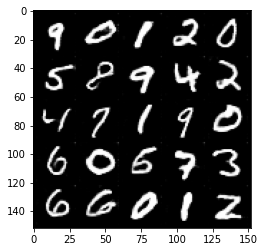

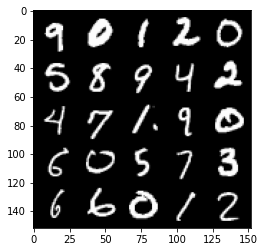

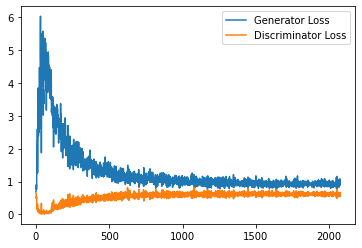

Epoch 89, step 42000: Generator loss: 0.9461857843399047, discriminator loss: 0.6097295444607734


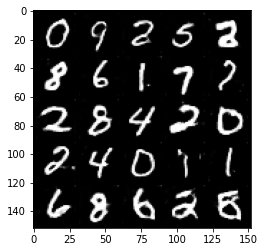

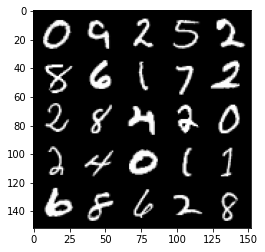

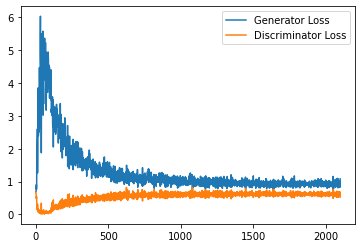

Epoch 90, step 42500: Generator loss: 0.9234938741922378, discriminator loss: 0.6104151384234429


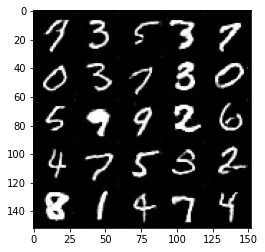

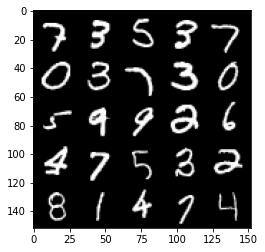

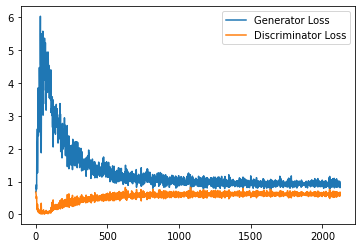

Epoch 91, step 43000: Generator loss: 0.9404035764932632, discriminator loss: 0.6096021210551262


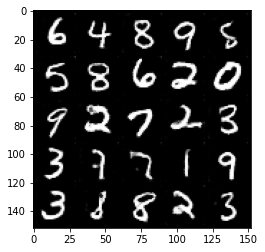

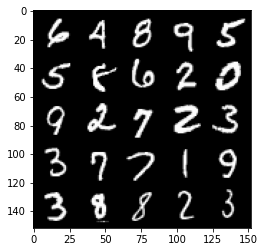

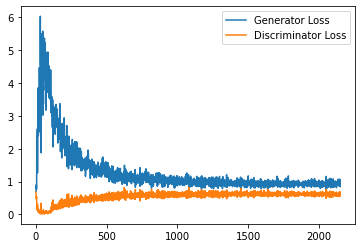

Epoch 92, step 43500: Generator loss: 0.9683221286535263, discriminator loss: 0.6082594485282898


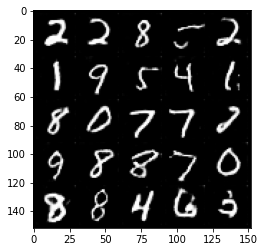

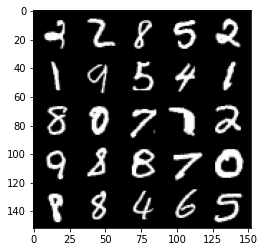

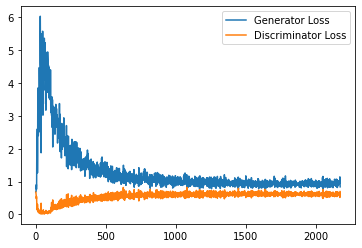

Epoch 93, step 44000: Generator loss: 0.9414207097291947, discriminator loss: 0.6080024417042732


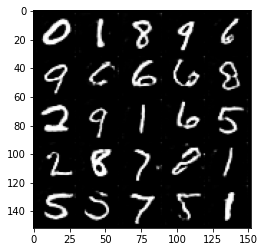

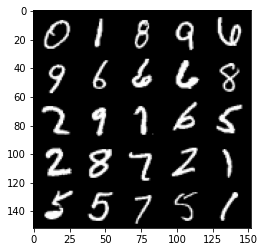

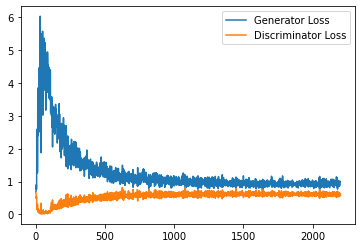

Epoch 94, step 44500: Generator loss: 0.9423200219869614, discriminator loss: 0.6135844593048095


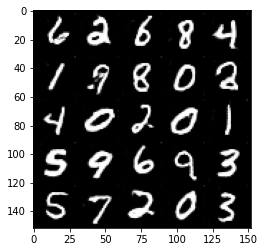

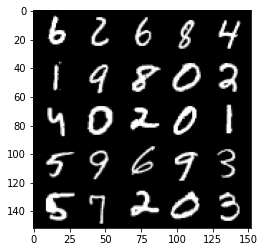

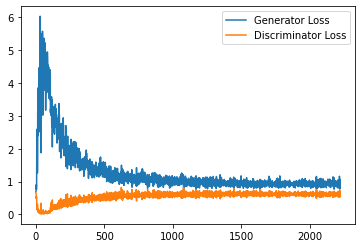

Epoch 95, step 45000: Generator loss: 0.9511022237539292, discriminator loss: 0.6085869011878967


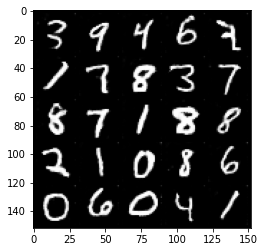

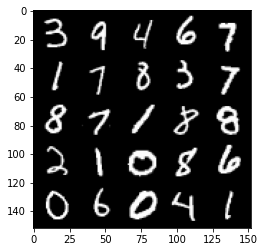

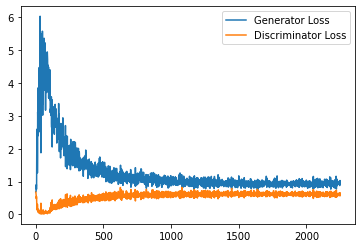

Epoch 97, step 45500: Generator loss: 0.9444402315616608, discriminator loss: 0.6034112502336502


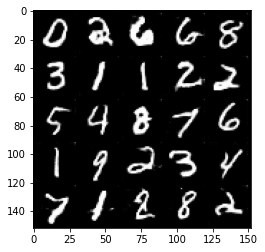

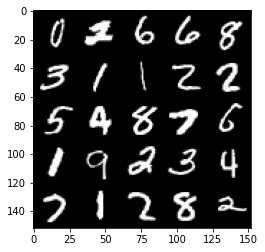

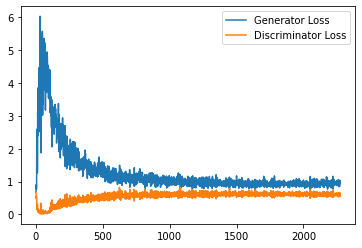

Epoch 98, step 46000: Generator loss: 0.9435808967351913, discriminator loss: 0.6072509489655494


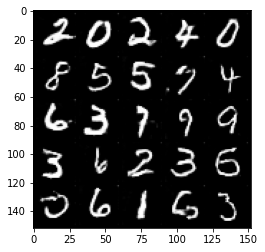

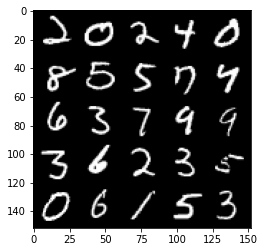

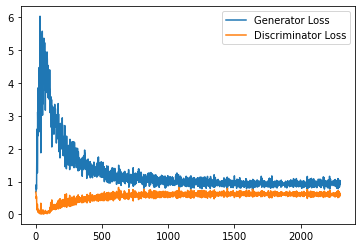

Epoch 99, step 46500: Generator loss: 0.9511169642210007, discriminator loss: 0.6079898464083672


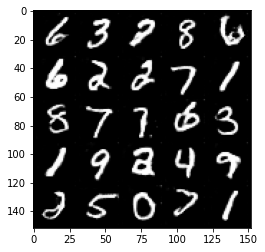

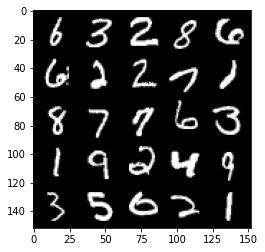

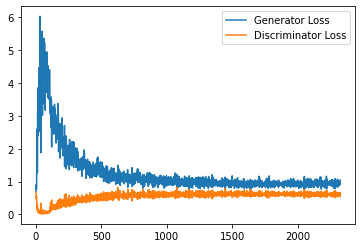

Epoch 100, step 47000: Generator loss: 0.9341183072328567, discriminator loss: 0.6045522137284279


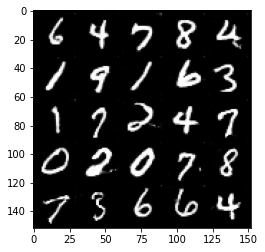

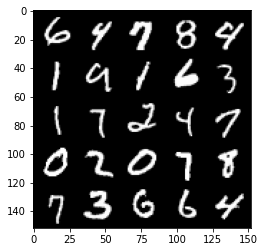

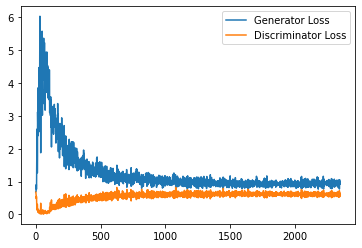

Epoch 101, step 47500: Generator loss: 0.9512244870662689, discriminator loss: 0.6094237437844277


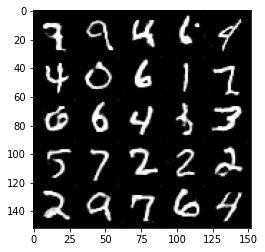

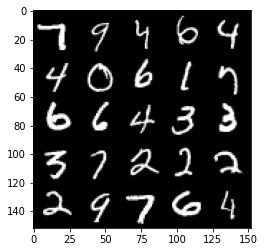

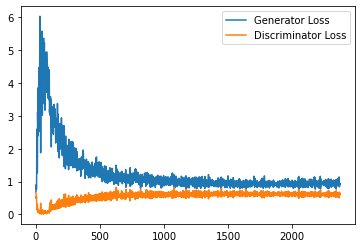

Epoch 102, step 48000: Generator loss: 0.9410252319574356, discriminator loss: 0.6031113903522491


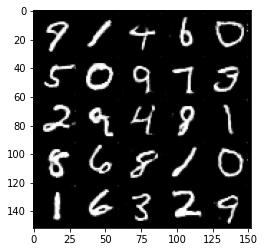

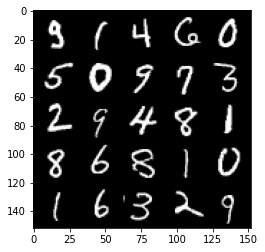

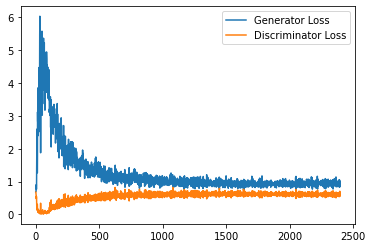

Epoch 103, step 48500: Generator loss: 0.9622138693332672, discriminator loss: 0.6043910036683082


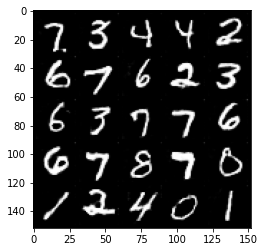

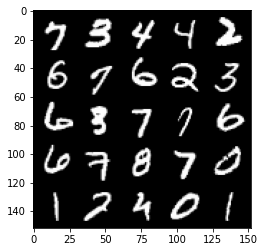

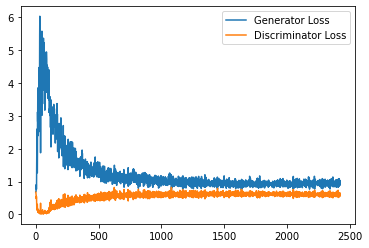

Epoch 104, step 49000: Generator loss: 0.9396726078987122, discriminator loss: 0.6007039873600006


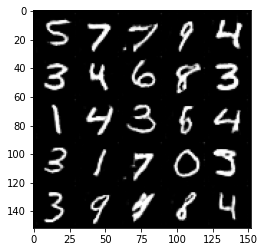

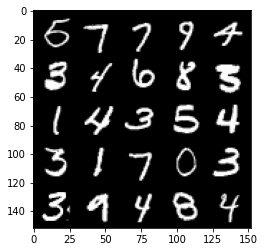

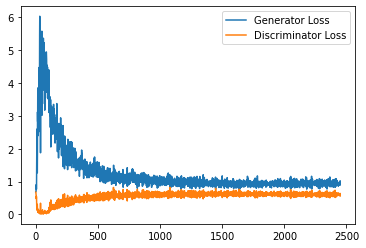

Epoch 105, step 49500: Generator loss: 0.9681938103437424, discriminator loss: 0.6021493158340454


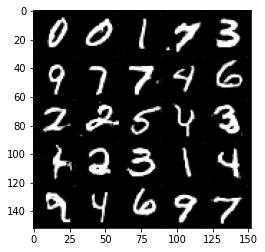

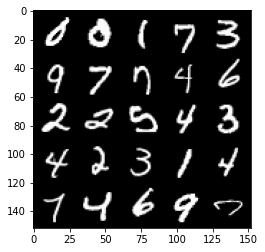

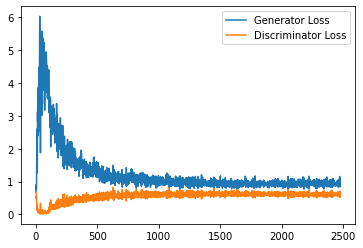

Epoch 106, step 50000: Generator loss: 0.9394080767631531, discriminator loss: 0.6038794152140617


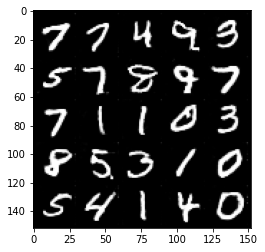

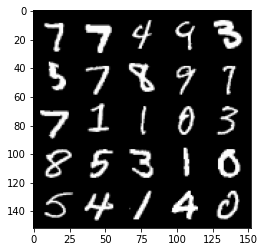

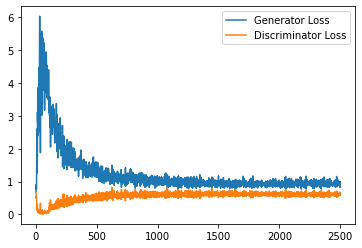

Epoch 107, step 50500: Generator loss: 0.9502171784639358, discriminator loss: 0.605394512951374


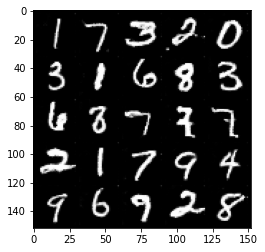

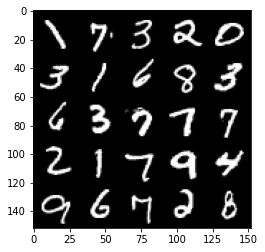

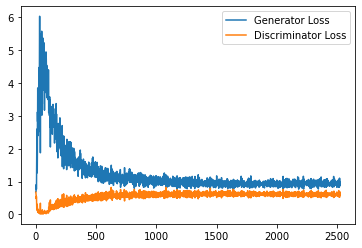

Epoch 108, step 51000: Generator loss: 0.9677049844264984, discriminator loss: 0.6021693229675293


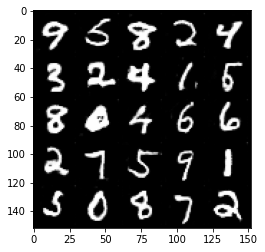

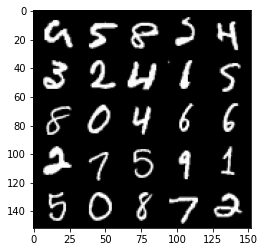

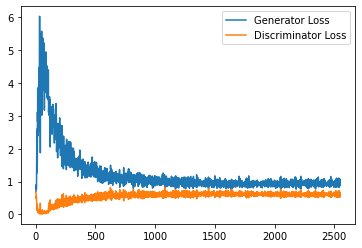

Epoch 109, step 51500: Generator loss: 0.9733115943670273, discriminator loss: 0.6031571879982949


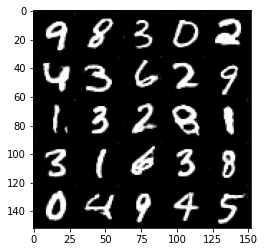

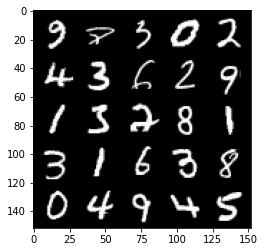

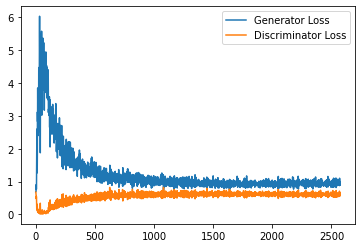

Epoch 110, step 52000: Generator loss: 0.9622171651124954, discriminator loss: 0.5956206634640694


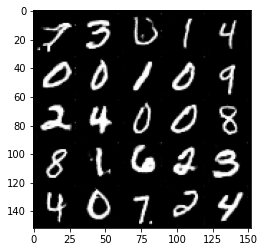

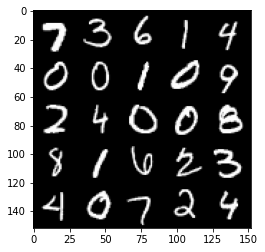

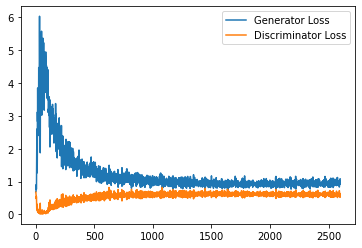

Epoch 111, step 52500: Generator loss: 0.9579603426456451, discriminator loss: 0.601703381717205


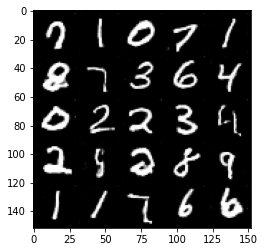

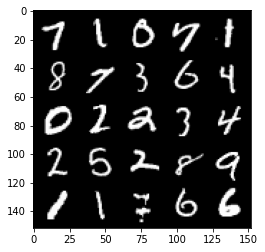

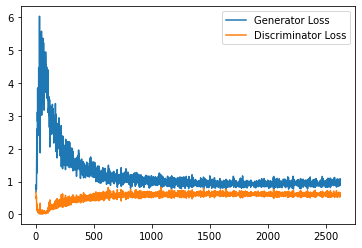

Epoch 113, step 53000: Generator loss: 0.9607761752605438, discriminator loss: 0.6013486057519912


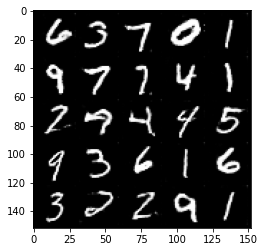

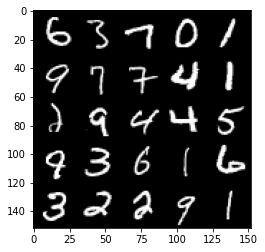

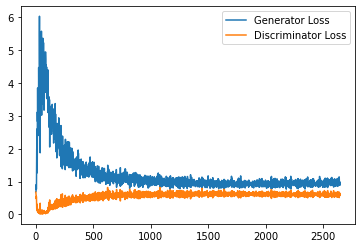

Epoch 114, step 53500: Generator loss: 0.9543771314620971, discriminator loss: 0.598529751598835


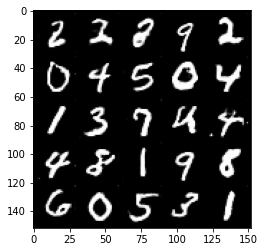

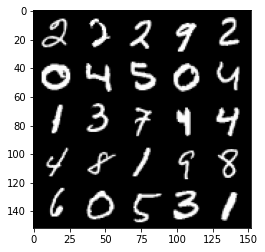

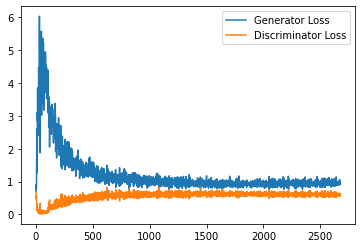

Epoch 115, step 54000: Generator loss: 0.9628672310113907, discriminator loss: 0.5955208594799042


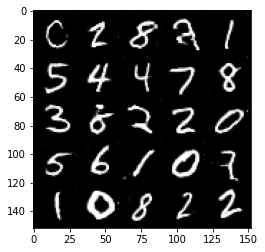

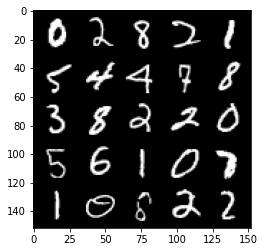

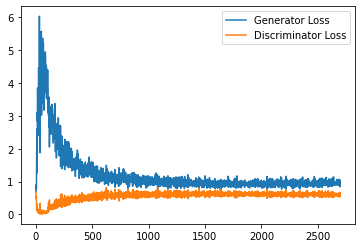

Epoch 116, step 54500: Generator loss: 0.9868974678516388, discriminator loss: 0.5973940593600273


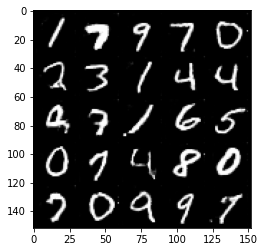

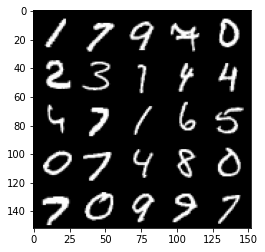

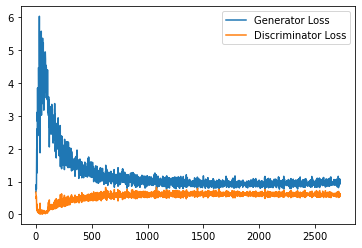

Epoch 117, step 55000: Generator loss: 0.9644027106761932, discriminator loss: 0.6019988339543343


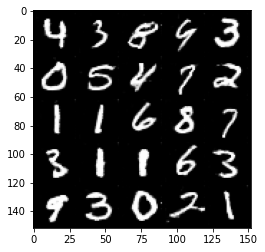

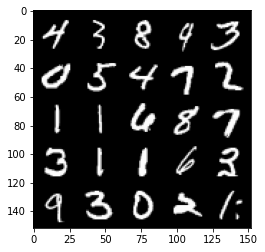

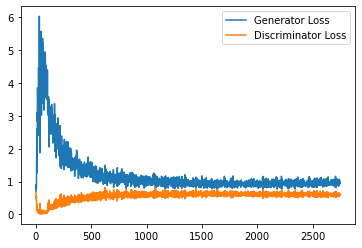

Epoch 118, step 55500: Generator loss: 0.9532066870927811, discriminator loss: 0.6023157352209091


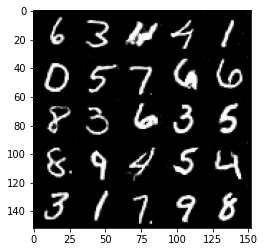

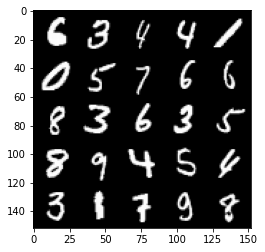

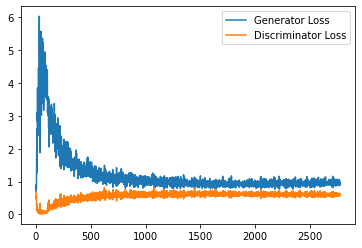

Epoch 119, step 56000: Generator loss: 0.9800212363004684, discriminator loss: 0.5933174620270729


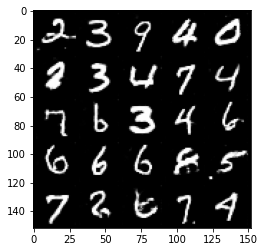

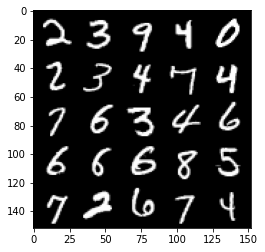

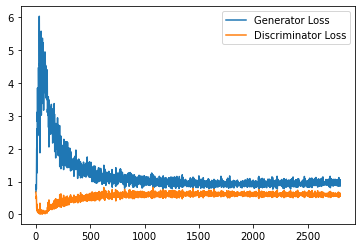

Epoch 120, step 56500: Generator loss: 0.9589204505681992, discriminator loss: 0.6012373740077018


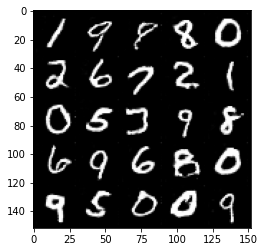

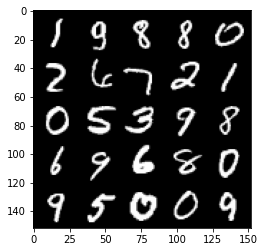

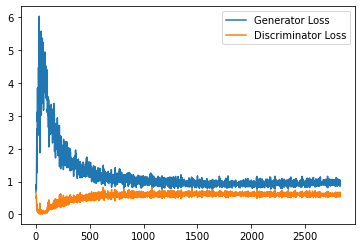

Epoch 121, step 57000: Generator loss: 0.9736438773870468, discriminator loss: 0.5936988683342934


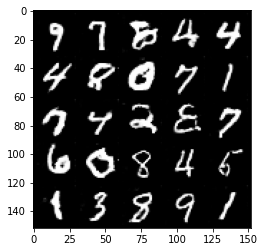

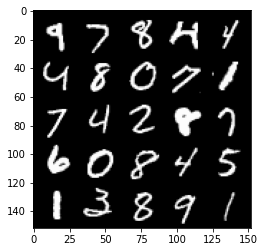

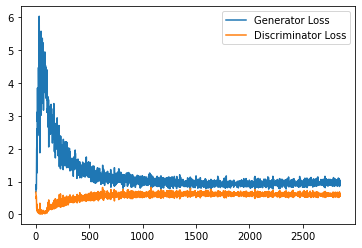

Epoch 122, step 57500: Generator loss: 0.9711487797498704, discriminator loss: 0.5986148234009743


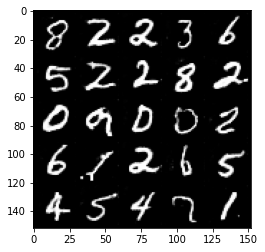

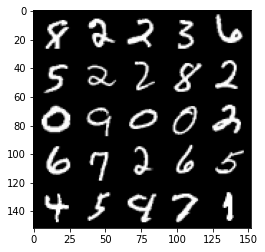

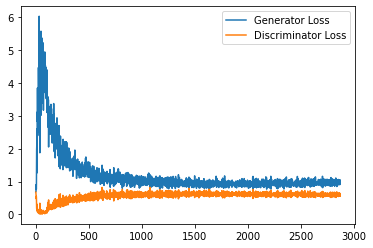

Epoch 123, step 58000: Generator loss: 0.9619557194709778, discriminator loss: 0.599930743098259


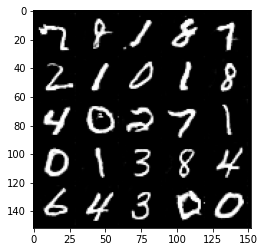

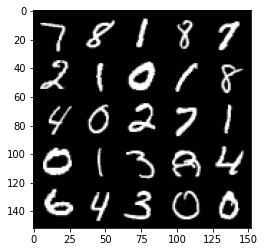

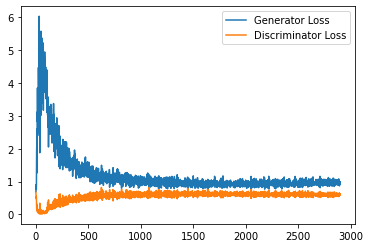

Epoch 124, step 58500: Generator loss: 0.9778961571455002, discriminator loss: 0.592663134753704


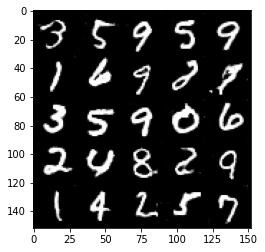

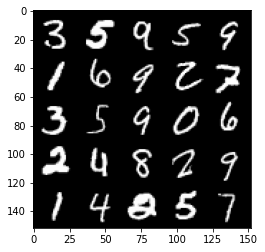

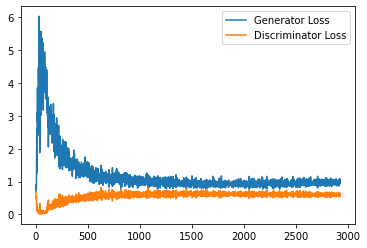

Epoch 125, step 59000: Generator loss: 0.9844347834587097, discriminator loss: 0.5977231531143189


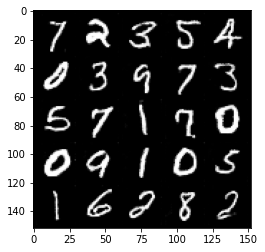

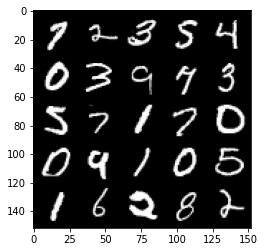

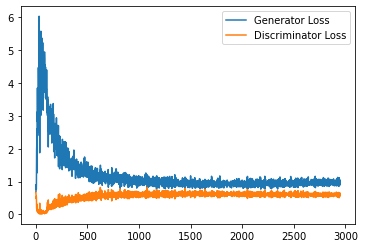

Epoch 126, step 59500: Generator loss: 0.9833237587213516, discriminator loss: 0.5985222665071488


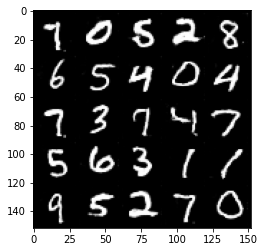

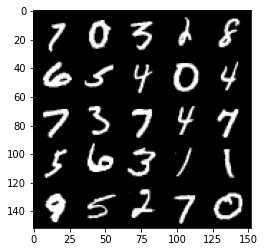

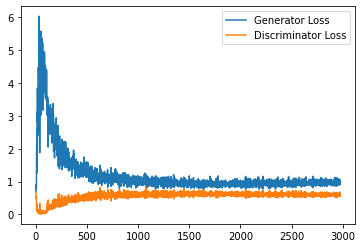

Epoch 127, step 60000: Generator loss: 0.9772483837604523, discriminator loss: 0.5962312031388283


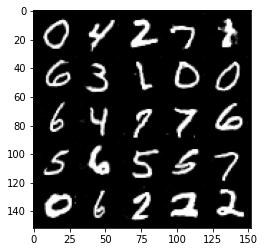

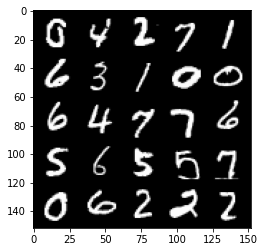

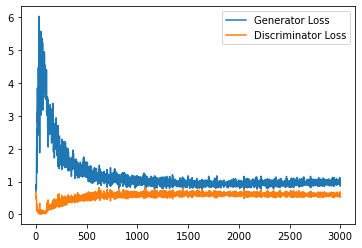

Epoch 128, step 60500: Generator loss: 0.9717317712306976, discriminator loss: 0.5982921649217605


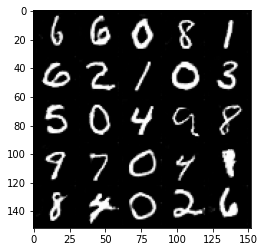

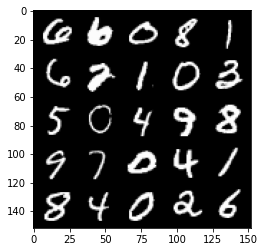

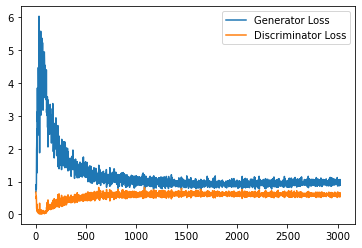

Epoch 130, step 61000: Generator loss: 0.9735452501773835, discriminator loss: 0.5979693002700806


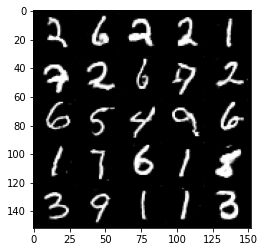

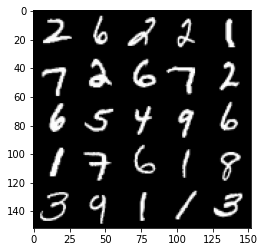

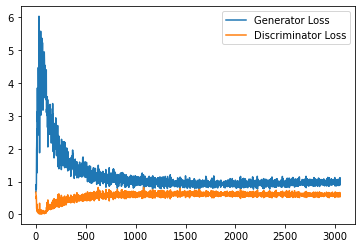

Epoch 131, step 61500: Generator loss: 0.9645571700334549, discriminator loss: 0.5986761886477471


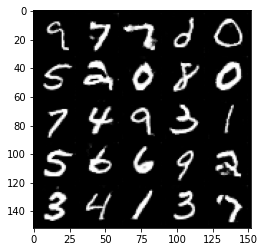

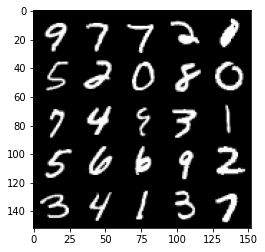

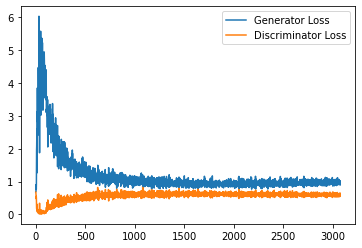

Epoch 132, step 62000: Generator loss: 0.9880307402610778, discriminator loss: 0.5984833416342735


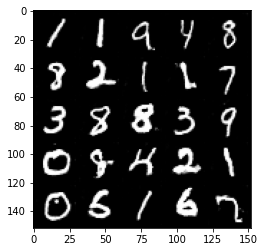

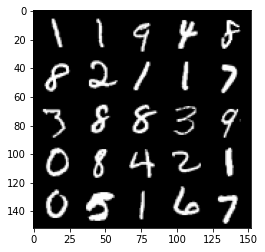

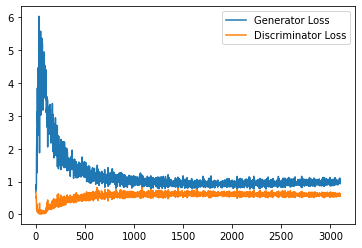

Epoch 133, step 62500: Generator loss: 0.9794295043945312, discriminator loss: 0.5971159944534302


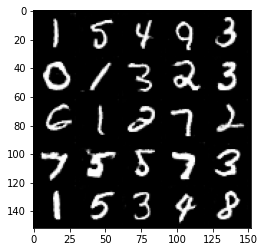

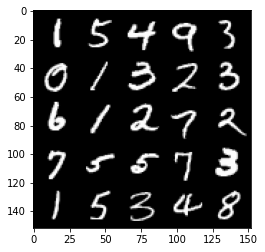

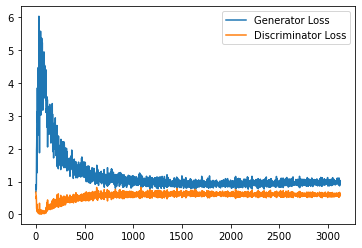

Epoch 134, step 63000: Generator loss: 0.9715060023069382, discriminator loss: 0.5932049203515053


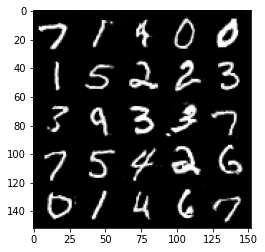

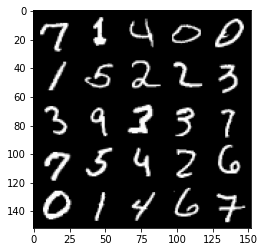

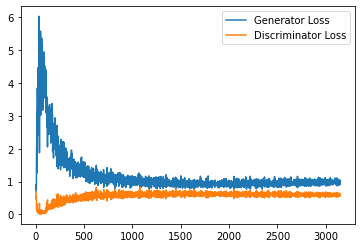

Epoch 135, step 63500: Generator loss: 0.9800123426914215, discriminator loss: 0.5992304309010505


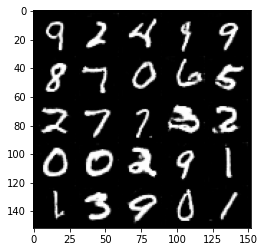

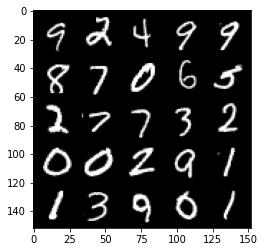

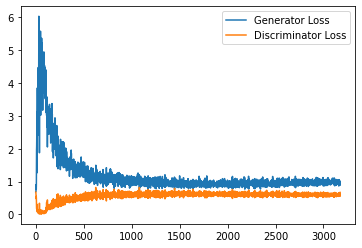

Epoch 136, step 64000: Generator loss: 0.9723196566104889, discriminator loss: 0.5983025885820389


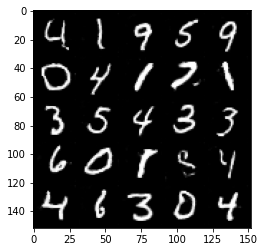

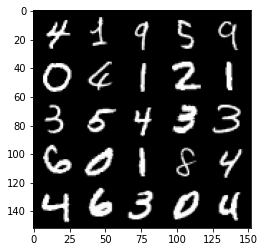

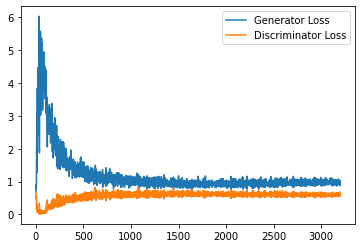

Epoch 137, step 64500: Generator loss: 0.9780830688476563, discriminator loss: 0.5944437795877456


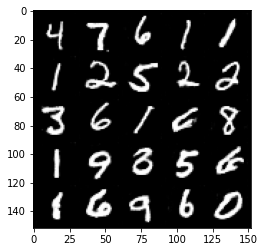

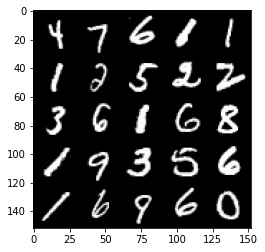

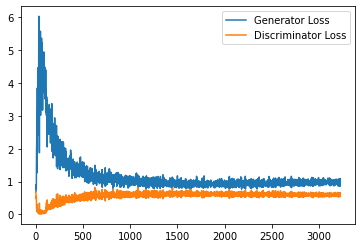

Epoch 138, step 65000: Generator loss: 0.987083221077919, discriminator loss: 0.5994015858769417


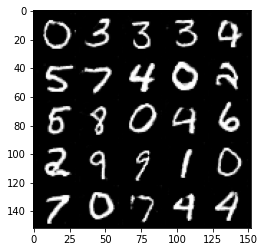

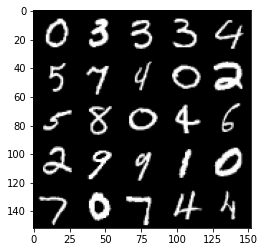

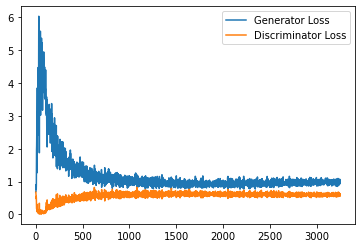

Epoch 139, step 65500: Generator loss: 0.9734784007072449, discriminator loss: 0.5993920261859894


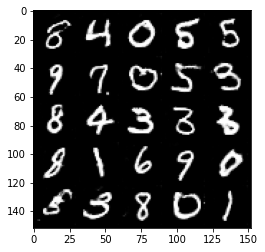

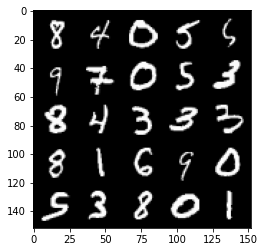

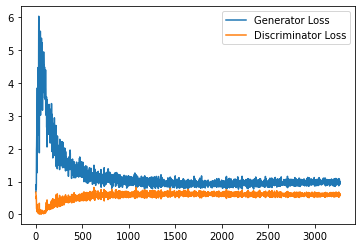

Epoch 140, step 66000: Generator loss: 0.9787439820766449, discriminator loss: 0.598108693242073


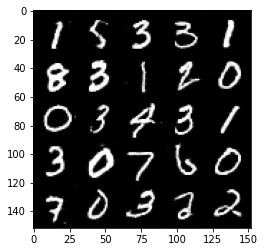

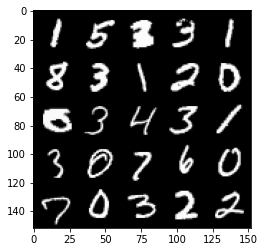

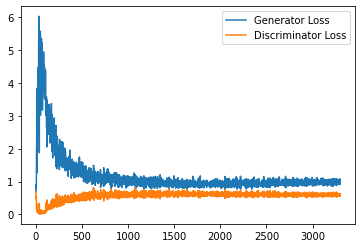

Epoch 141, step 66500: Generator loss: 0.9835744132995605, discriminator loss: 0.5949317206144333


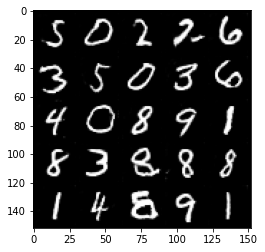

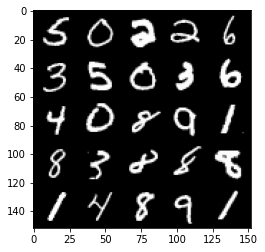

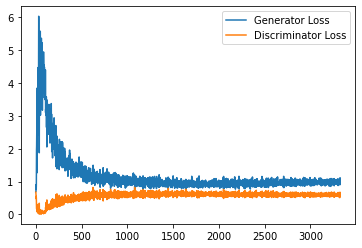

Epoch 142, step 67000: Generator loss: 0.9845283286571502, discriminator loss: 0.6004334308505058


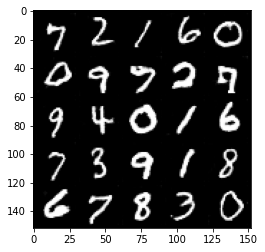

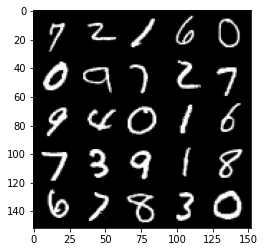

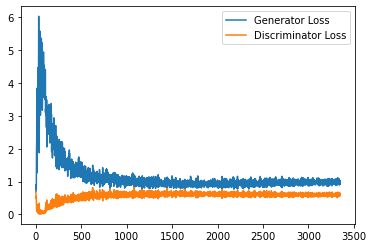

Epoch 143, step 67500: Generator loss: 1.004628519654274, discriminator loss: 0.5964650775790215


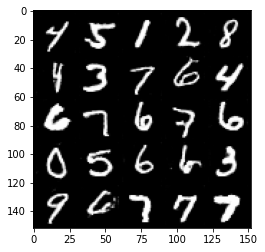

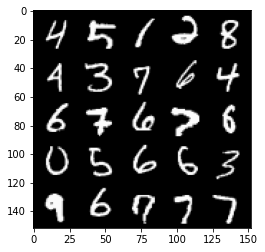

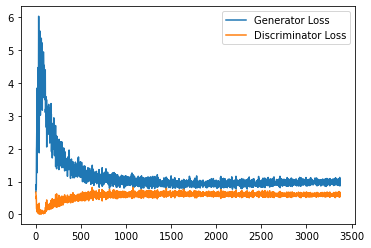

Epoch 144, step 68000: Generator loss: 0.9673804943561554, discriminator loss: 0.6029082888364792


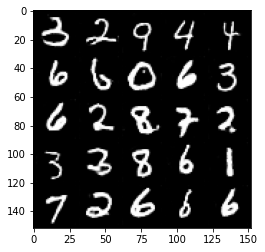

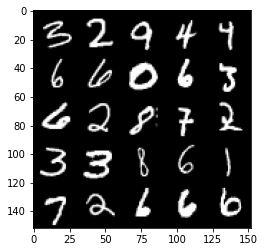

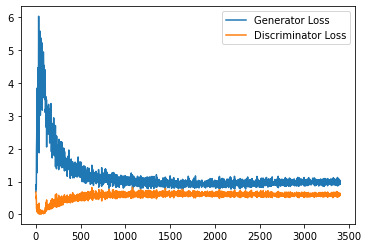

Epoch 146, step 68500: Generator loss: 0.9852334462404251, discriminator loss: 0.5964549659490586


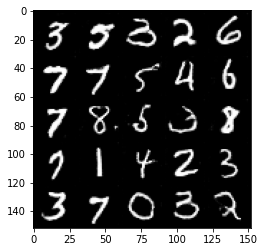

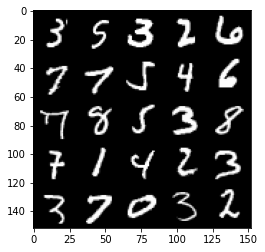

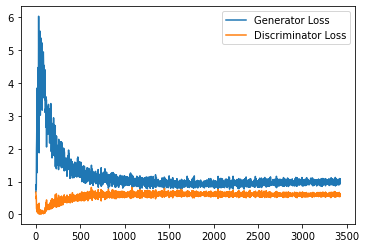

Epoch 147, step 69000: Generator loss: 0.9908927793502808, discriminator loss: 0.5970044701695442


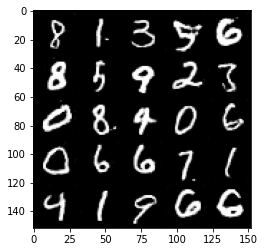

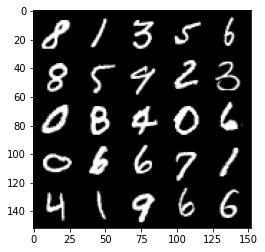

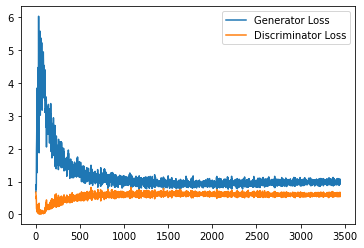

Epoch 148, step 69500: Generator loss: 0.9922986011505127, discriminator loss: 0.5995708692669869


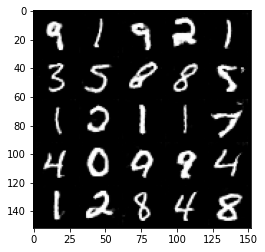

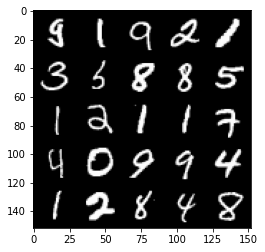

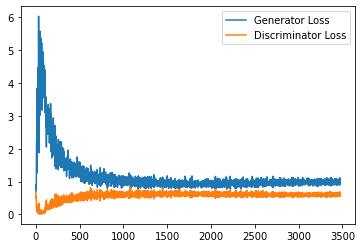

Epoch 149, step 70000: Generator loss: 0.9822826161384582, discriminator loss: 0.5984231383800507


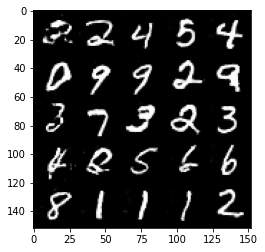

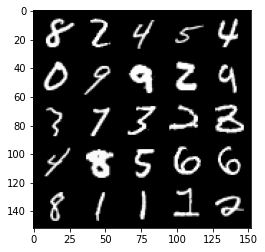

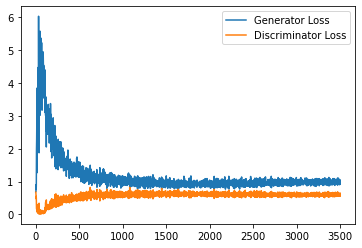

Epoch 150, step 70500: Generator loss: 0.9853131515979767, discriminator loss: 0.5996364649534226


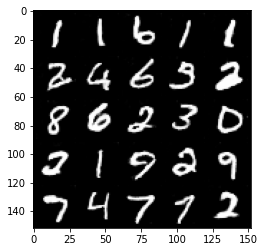

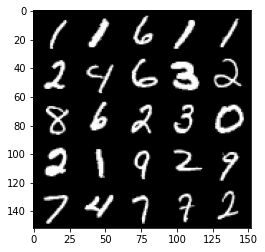

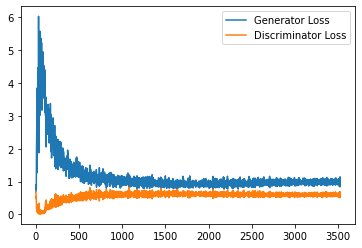

Epoch 151, step 71000: Generator loss: 0.9788615033626556, discriminator loss: 0.6050984969139099


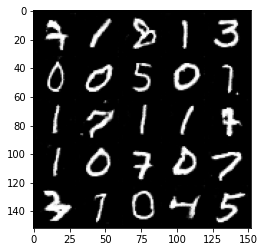

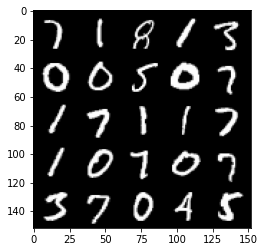

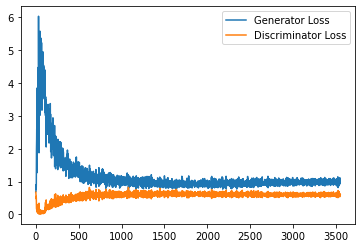

Epoch 152, step 71500: Generator loss: 0.9703495683670044, discriminator loss: 0.6012625031471253


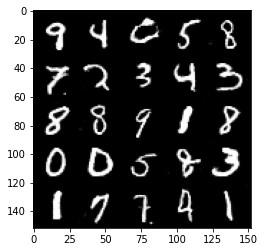

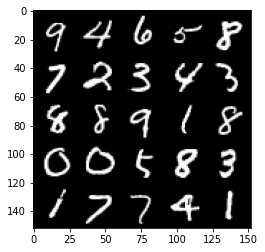

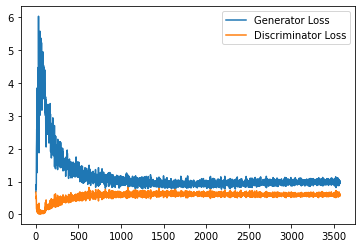

Epoch 153, step 72000: Generator loss: 0.9807077445983887, discriminator loss: 0.5983612472414971


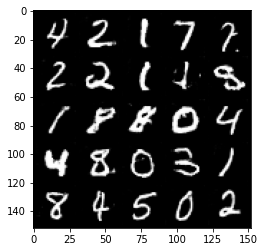

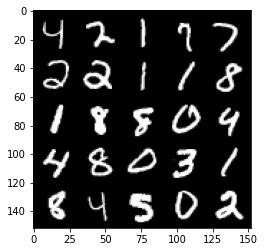

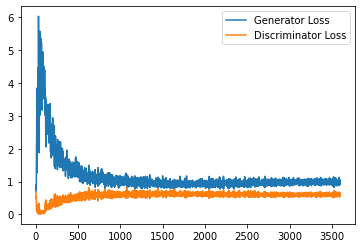

Epoch 154, step 72500: Generator loss: 0.9853119688034058, discriminator loss: 0.6027387338876724


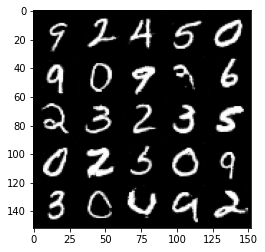

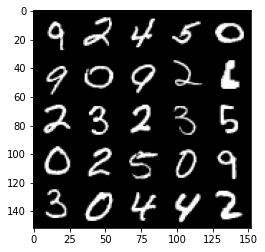

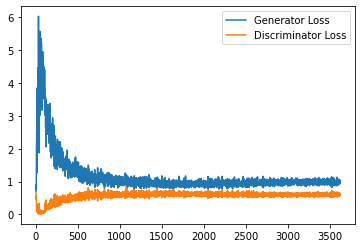

Epoch 155, step 73000: Generator loss: 0.9784179624319077, discriminator loss: 0.5972850449681282


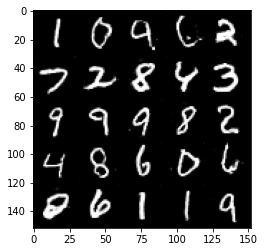

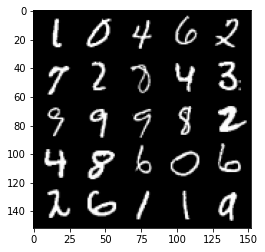

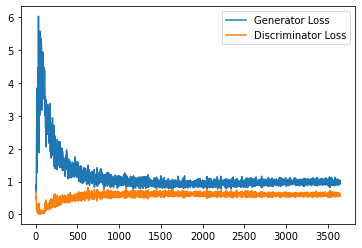

Epoch 156, step 73500: Generator loss: 0.973861541390419, discriminator loss: 0.6001468749046326


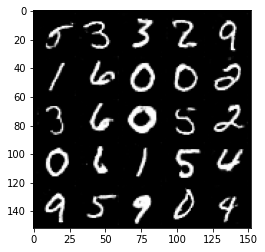

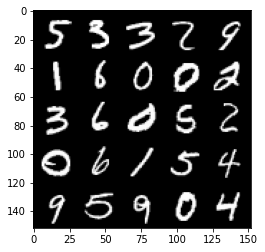

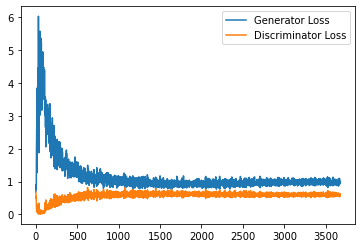

Epoch 157, step 74000: Generator loss: 0.9783087714910507, discriminator loss: 0.5997809398770332


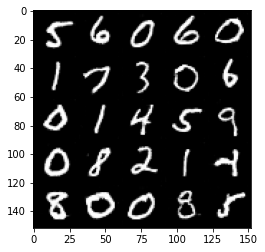

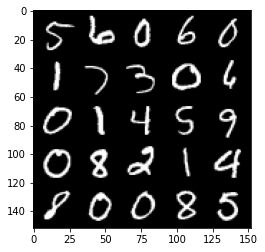

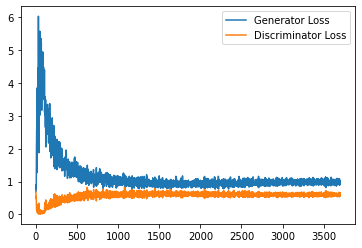

Epoch 158, step 74500: Generator loss: 0.9883839248418808, discriminator loss: 0.5994708042144775


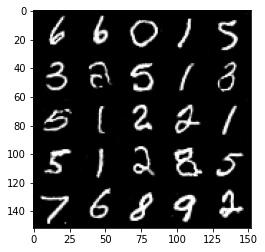

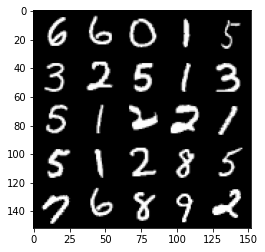

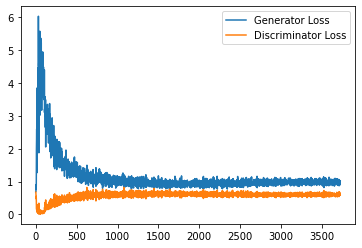

Epoch 159, step 75000: Generator loss: 0.9886201224327087, discriminator loss: 0.602593022942543


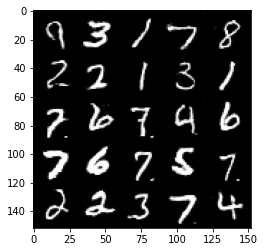

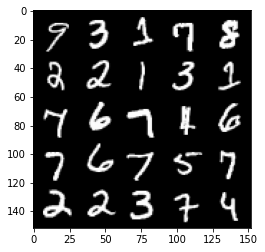

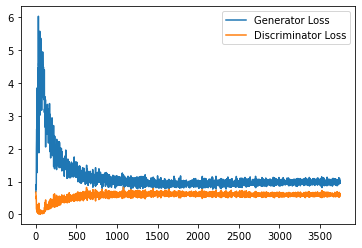

Epoch 160, step 75500: Generator loss: 0.9686393451690674, discriminator loss: 0.6030006967186928


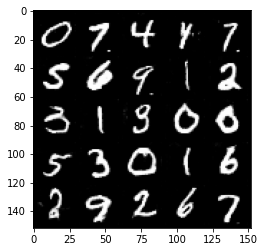

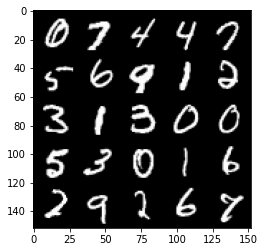

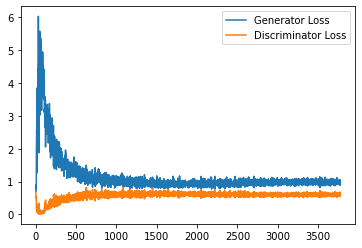

Epoch 162, step 76000: Generator loss: 0.9956756030321121, discriminator loss: 0.6054805845618249


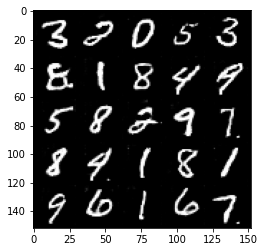

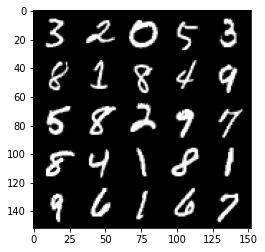

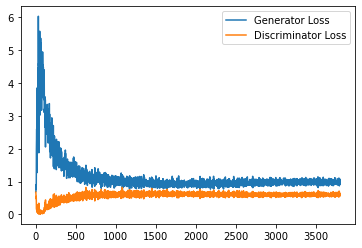

Epoch 163, step 76500: Generator loss: 0.9843673329353333, discriminator loss: 0.6006148417592049


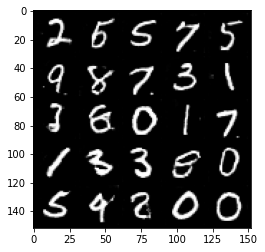

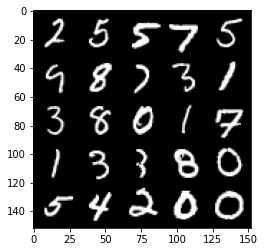

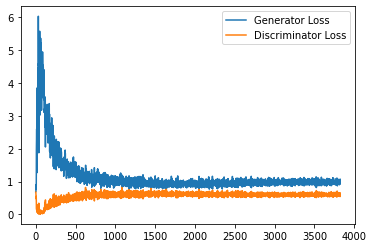

Epoch 164, step 77000: Generator loss: 0.9654738057851792, discriminator loss: 0.6031221897602081


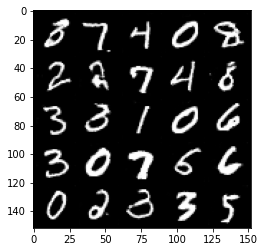

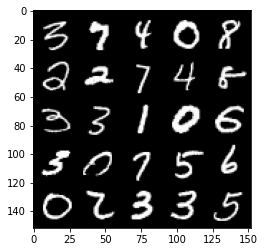

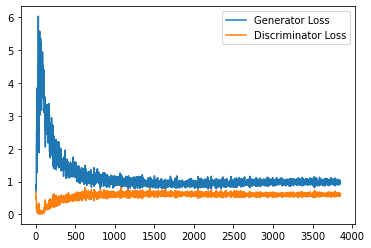

Epoch 165, step 77500: Generator loss: 0.9791542536020279, discriminator loss: 0.6011030961275101


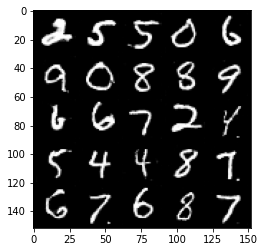

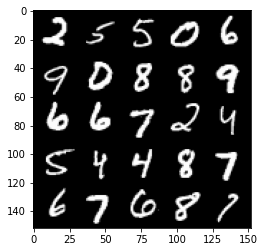

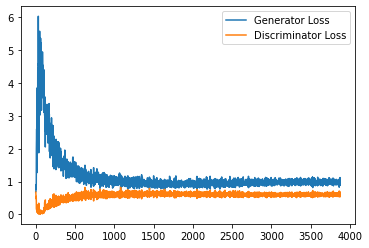

Epoch 166, step 78000: Generator loss: 1.0029947137832642, discriminator loss: 0.5990014680624008


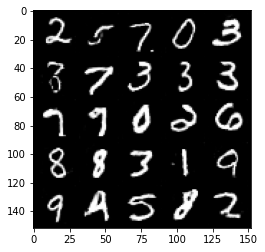

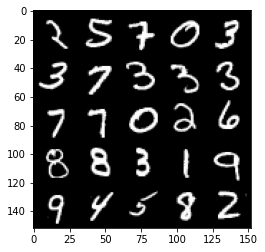

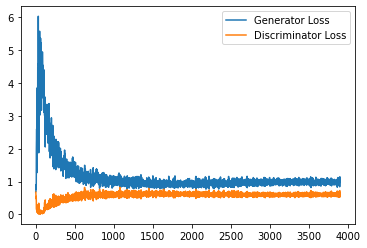

Epoch 167, step 78500: Generator loss: 0.9878197243213653, discriminator loss: 0.6039031995534897


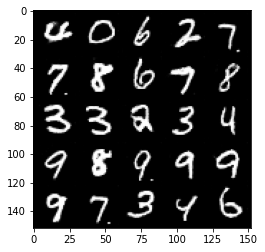

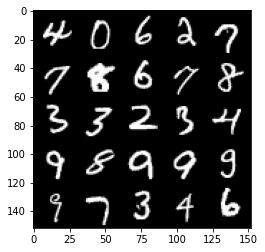

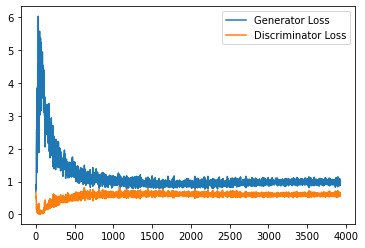

Epoch 168, step 79000: Generator loss: 0.991086804151535, discriminator loss: 0.6038041080236435


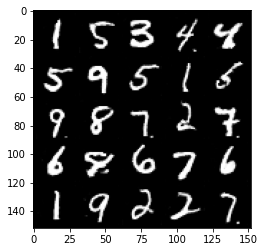

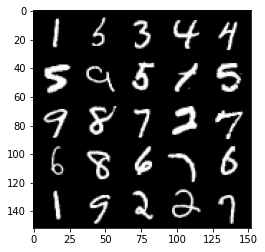

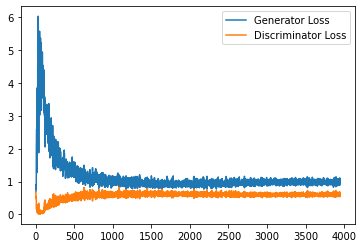

Epoch 169, step 79500: Generator loss: 0.9891180114746094, discriminator loss: 0.5995861450433732


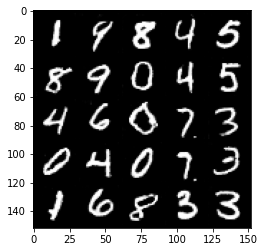

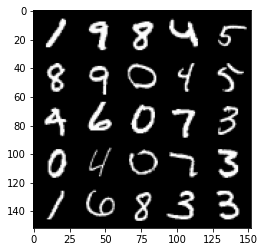

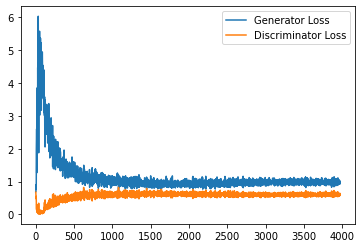

Epoch 170, step 80000: Generator loss: 0.9815625420808792, discriminator loss: 0.6001912145018578


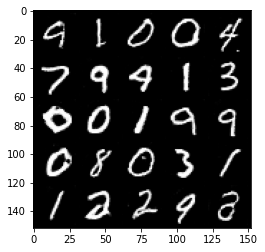

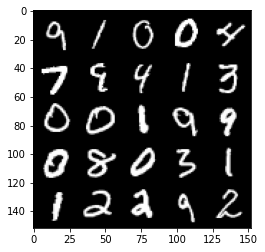

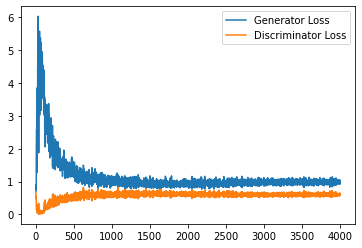

Epoch 171, step 80500: Generator loss: 0.9853704990148544, discriminator loss: 0.60307550740242


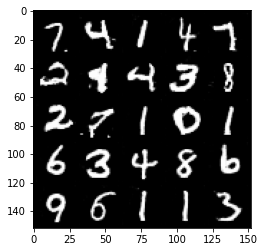

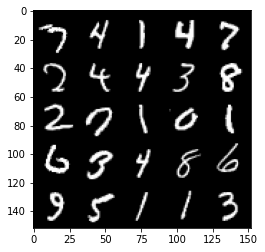

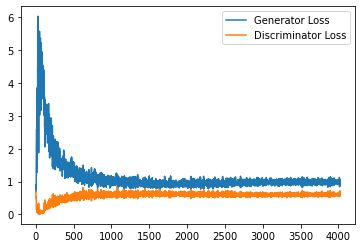

Epoch 172, step 81000: Generator loss: 0.9877372782230377, discriminator loss: 0.6030517700910568


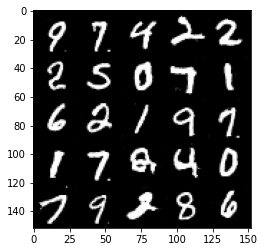

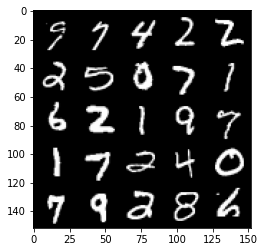

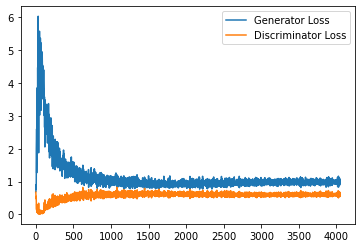

Epoch 173, step 81500: Generator loss: 0.9875252100229264, discriminator loss: 0.6001116548180581


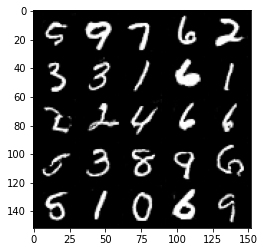

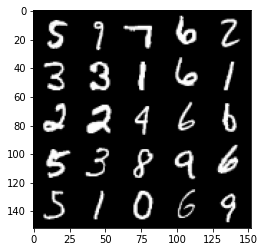

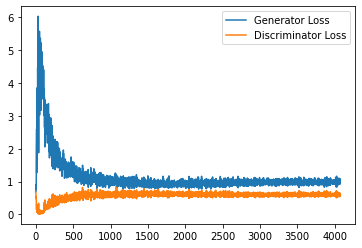

Epoch 174, step 82000: Generator loss: 0.9815869021415711, discriminator loss: 0.6007788160443306


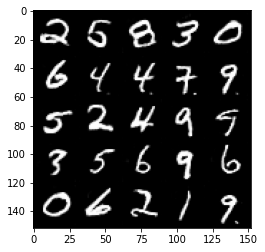

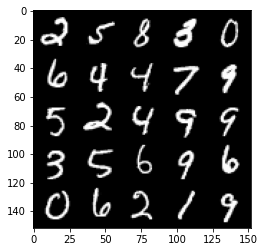

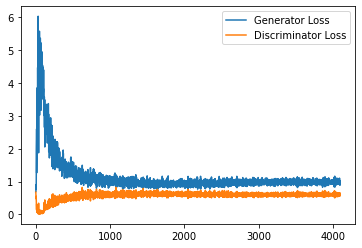

Epoch 175, step 82500: Generator loss: 0.9868317618370056, discriminator loss: 0.6065873295664788


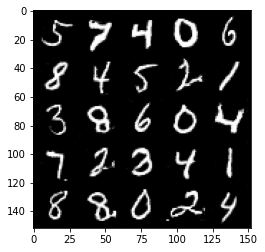

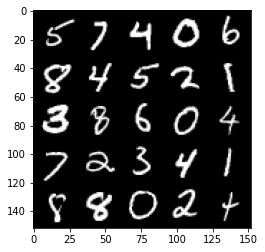

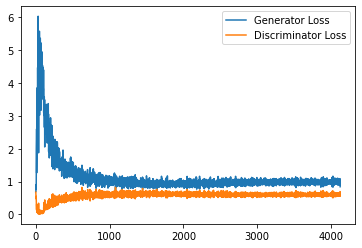

Epoch 176, step 83000: Generator loss: 0.982342001080513, discriminator loss: 0.6001092108488083


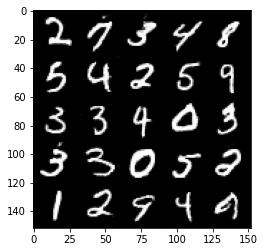

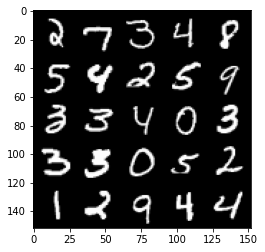

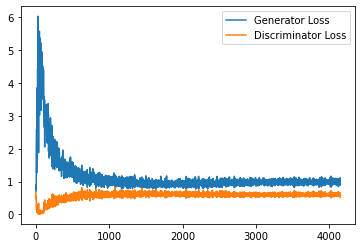

Epoch 178, step 83500: Generator loss: 0.9833184700012207, discriminator loss: 0.6051511437892914


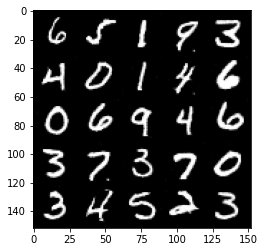

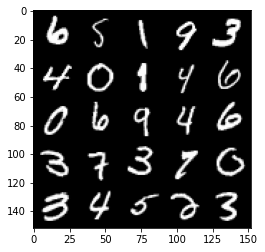

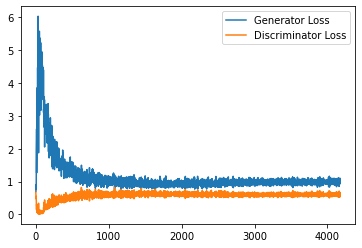

Epoch 179, step 84000: Generator loss: 0.9848178668022156, discriminator loss: 0.6070319233536721


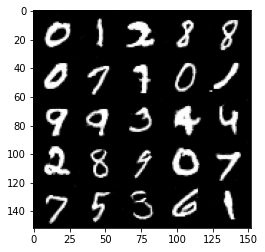

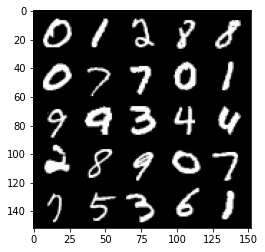

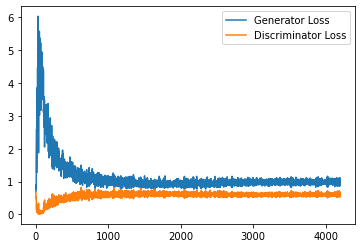

Epoch 180, step 84500: Generator loss: 0.9815628949403763, discriminator loss: 0.6011622850298881


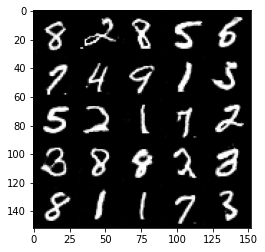

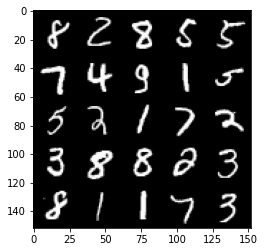

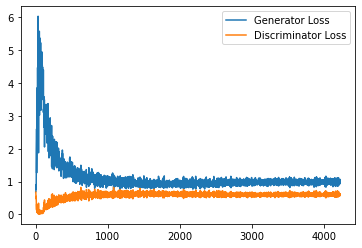

Epoch 181, step 85000: Generator loss: 0.9808190551996231, discriminator loss: 0.6053693004250527


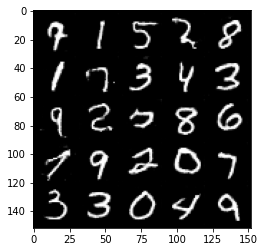

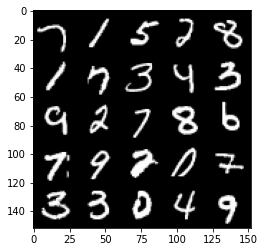

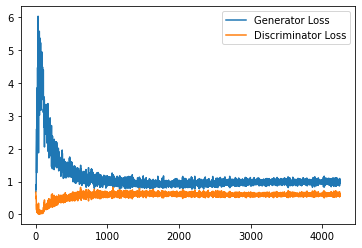

Epoch 182, step 85500: Generator loss: 1.011854300737381, discriminator loss: 0.6032738224864006


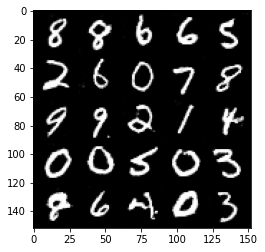

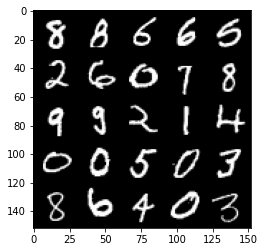

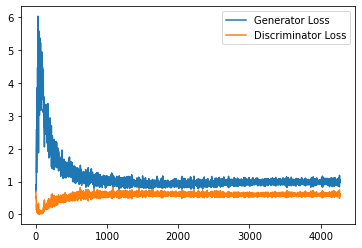

Epoch 183, step 86000: Generator loss: 0.9948436830043793, discriminator loss: 0.605930401802063


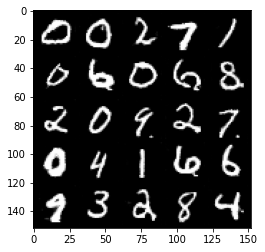

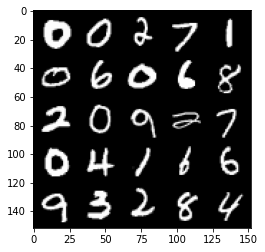

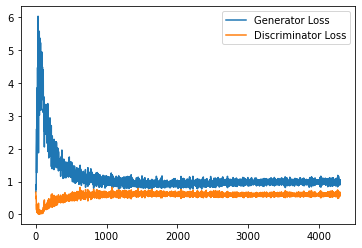

Epoch 184, step 86500: Generator loss: 0.9899061245918274, discriminator loss: 0.600318688094616


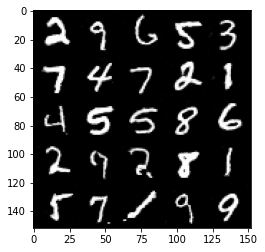

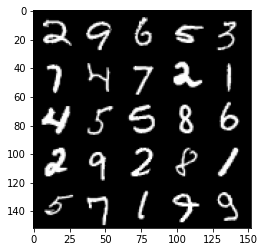

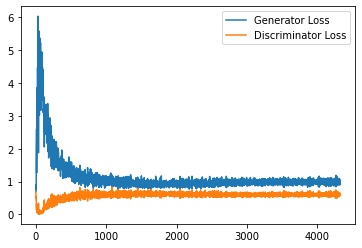

Epoch 185, step 87000: Generator loss: 0.975365283370018, discriminator loss: 0.6022843245863915


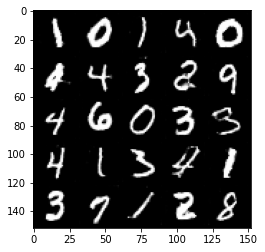

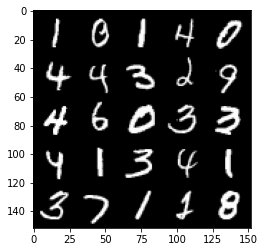

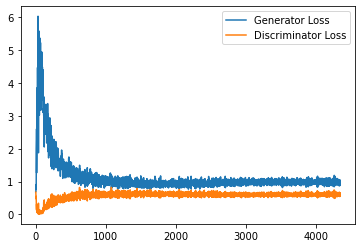

Epoch 186, step 87500: Generator loss: 0.9752396945953369, discriminator loss: 0.6029123248457908


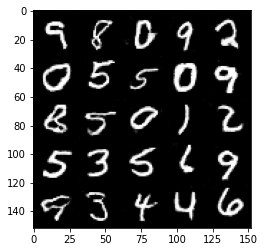

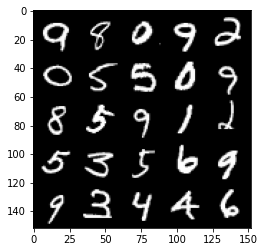

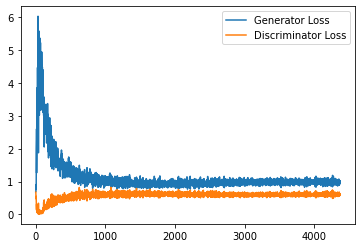

Epoch 187, step 88000: Generator loss: 0.9836708483695984, discriminator loss: 0.6047578845024109


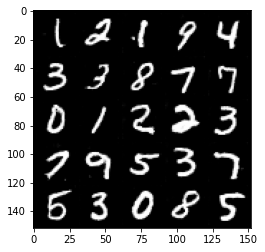

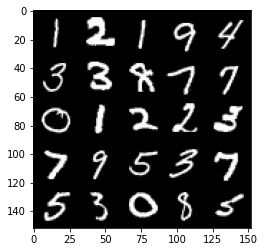

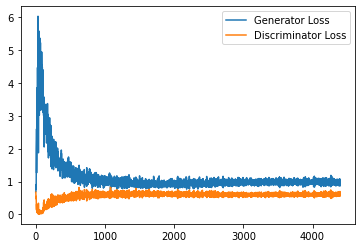

Epoch 188, step 88500: Generator loss: 0.9850220961570739, discriminator loss: 0.6010537108182907


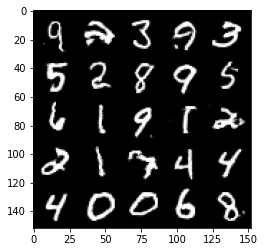

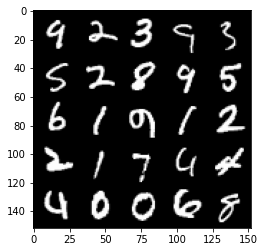

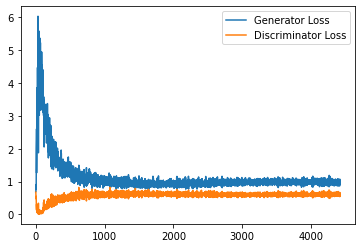

Epoch 189, step 89000: Generator loss: 0.9656295772790909, discriminator loss: 0.6067559787034988


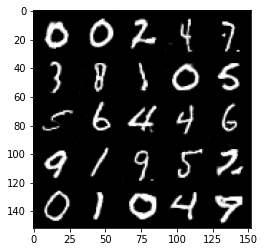

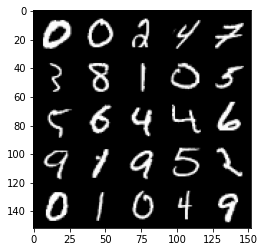

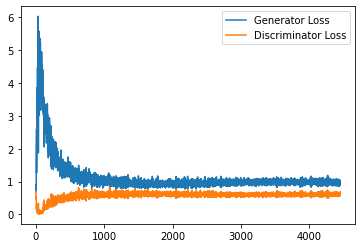

Epoch 190, step 89500: Generator loss: 0.98655462038517, discriminator loss: 0.6043472156524659


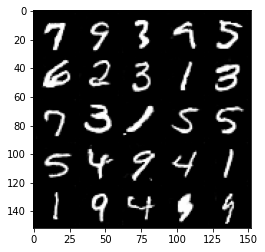

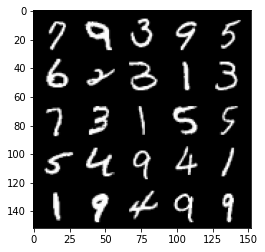

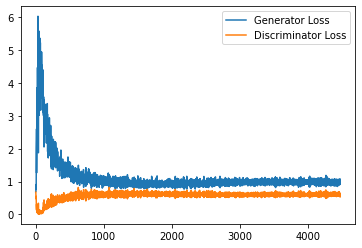

Epoch 191, step 90000: Generator loss: 0.9783259239196778, discriminator loss: 0.606073613345623


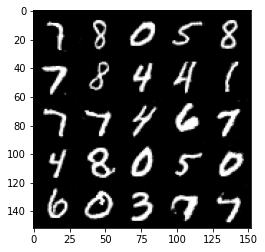

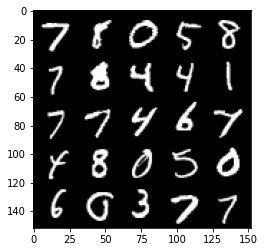

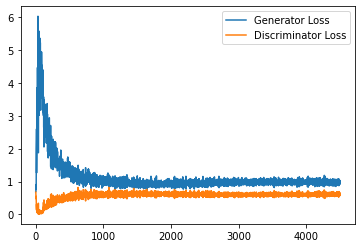

Epoch 192, step 90500: Generator loss: 0.9848796206712723, discriminator loss: 0.6058177562952042


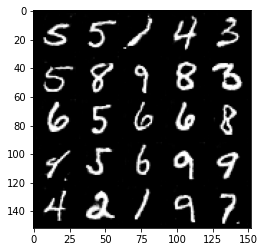

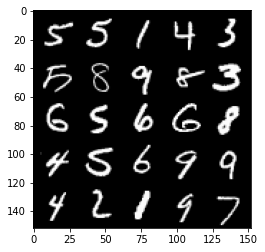

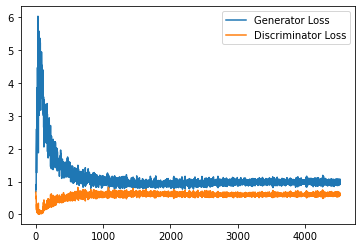

Epoch 194, step 91000: Generator loss: 0.9892749195098877, discriminator loss: 0.607285060286522


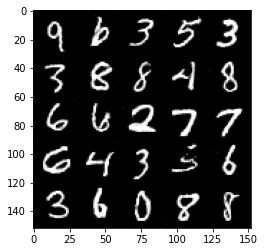

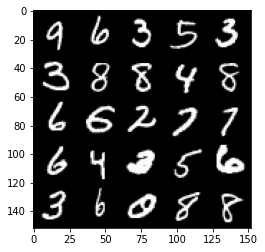

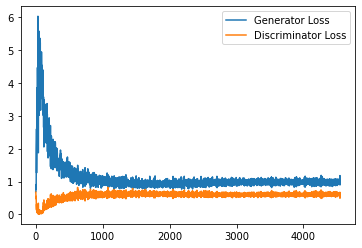

Epoch 195, step 91500: Generator loss: 0.9972821346521378, discriminator loss: 0.601845567703247


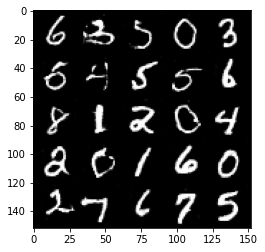

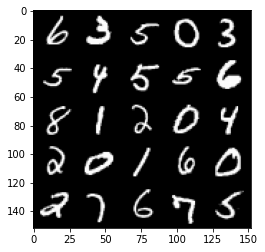

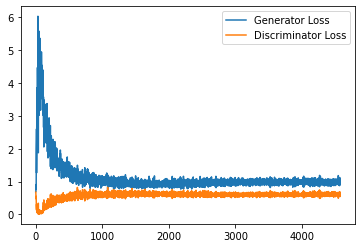

Epoch 196, step 92000: Generator loss: 0.9820650523900986, discriminator loss: 0.6047352392673493


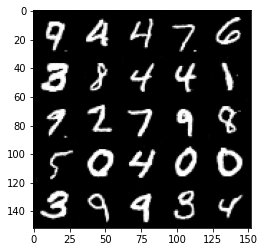

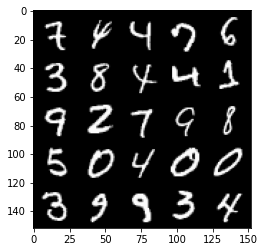

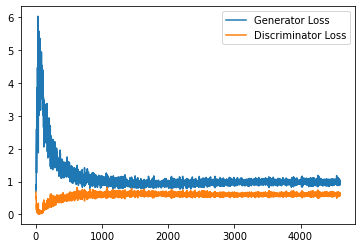

Epoch 197, step 92500: Generator loss: 0.978153862118721, discriminator loss: 0.607689095556736


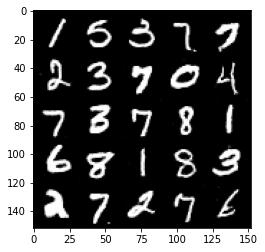

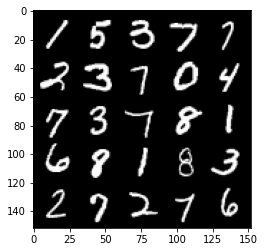

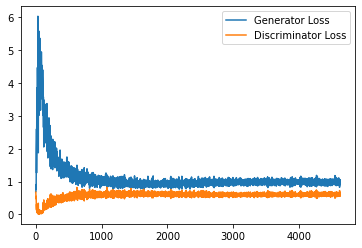

Epoch 198, step 93000: Generator loss: 0.977660187959671, discriminator loss: 0.6037063677310943


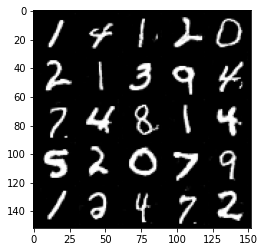

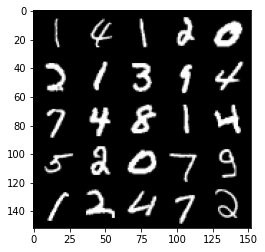

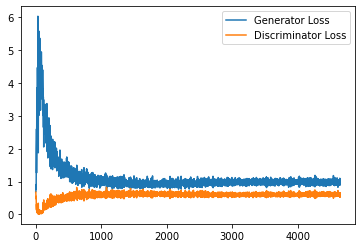

Epoch 199, step 93500: Generator loss: 0.9740706672668457, discriminator loss: 0.6084374499320984


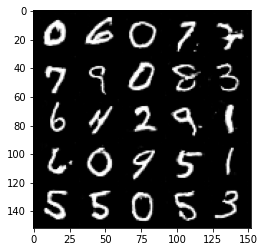

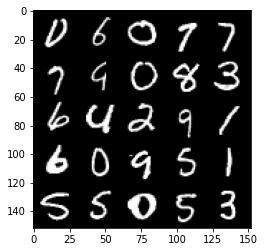

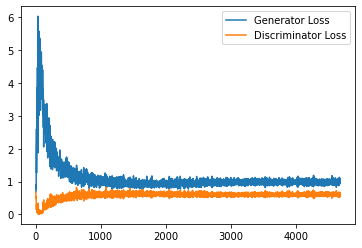

In [ ]:
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels.detach())
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Epoch {epoch}, step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [ ]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector


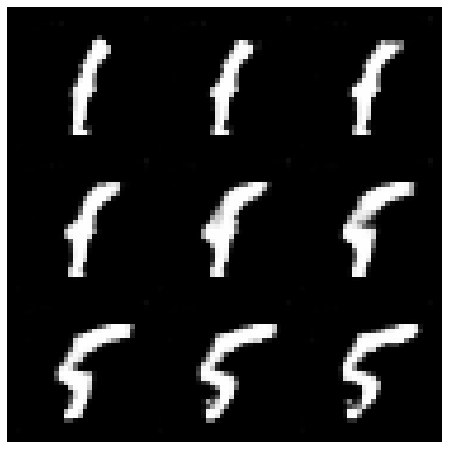

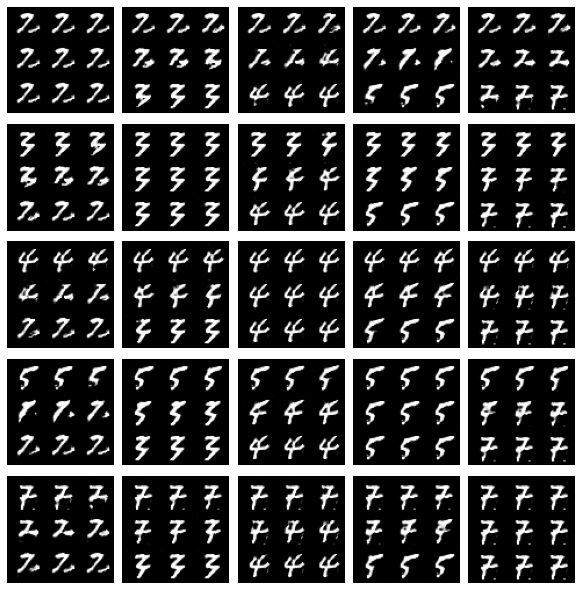

In [ ]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
plot_numbers = [2, 3, 4, 5, 7]
n_numbers = len(plot_numbers)
plt.figure(figsize=(8, 8))
for i, first_plot_number in enumerate(plot_numbers):
    for j, second_plot_number in enumerate(plot_numbers):
        plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
        interpolate_class(first_plot_number, second_plot_number)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()

#### Changing the Noise Vector


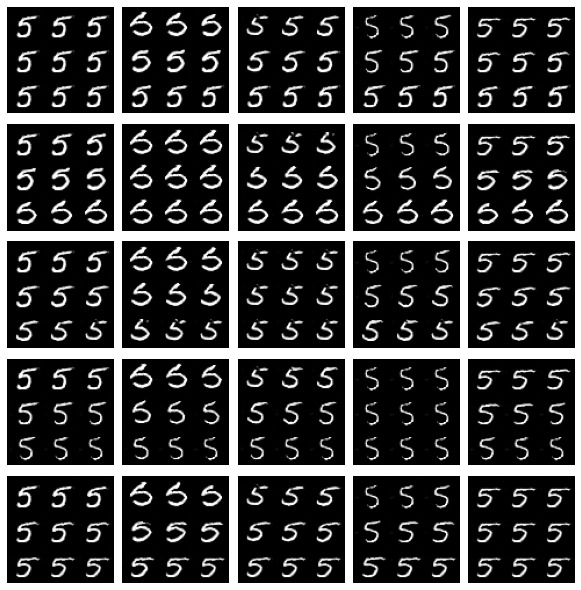

In [ ]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()